In [1]:
import cv2
import numpy as np
import random
import matplotlib.pyplot as plt
%matplotlib inline

import re
import os
import os.path
import glob
from PIL import Image
from skimage import io

from sklearn.preprocessing import LabelEncoder
from keras.utils import np_utils

from keras.models import Sequential,Model
from keras.layers import Input,Flatten,Dense,Dropout,GlobalAveragePooling2D,Conv2D,MaxPooling2D
from keras.preprocessing.image import img_to_array
from keras.preprocessing import image
from vis.utils import utils
from keras.applications import VGG16
from keras.applications.imagenet_utils import preprocess_input
from vis.visualization import visualize_cam,visualize_saliency, overlay
from keras import activations

# Disable GPU
os.environ['CUDA_VISIBLE_DEVICES'] = '1'

Using TensorFlow backend.


In [2]:
imagedir = "Datasets/malimg_paper_dataset_imgs"

In [3]:
cur_dir = os.getcwd()
os.chdir(imagedir)  # the parent folder with sub-folders

# Get number of samples per family
list_fams = sorted(os.listdir(os.getcwd()), key=str.lower)  # vector of strings with family names
no_imgs = []  # No. of samples per family
for i in range(len(list_fams)):
    os.chdir(list_fams[i])
    len1 = len(glob.glob('*.png'))  # assuming the images are stored as 'png'
    no_imgs.append(len1)
    os.chdir('..')
num_samples = np.sum(no_imgs)  # total number of all samples

# Compute the labels
y = np.zeros(num_samples)
pos = 0
label = 0
for i in no_imgs:
    print ("Label:%2d\tFamily: %15s\tNumber of images: %d" % (label, list_fams[label], i))
    for j in range(i):
        y[pos] = label
        pos += 1
    label += 1
num_classes = label

# Compute the features
width, height,channels = (224,224,3)
X = np.zeros((num_samples, width, height, channels))
cnt = 0
list_paths = [] # List of image paths
print("Processing images ...")
for i in range(len(list_fams)):
    for img_file in image.list_pictures(list_fams[i], ext='jpg|jpeg|bmp|png'):
        #print("[%d] Processing image: %s" % (cnt, img_file))
        list_paths.append(os.path.join(os.getcwd(),img_file))
        img = image.load_img(img_file, target_size=(224, 224))
        x = image.img_to_array(img)
        x = np.expand_dims(x, axis=0)
        x = preprocess_input(x)
        X[cnt] = x
        cnt += 1
print("Images processed: %d" %(cnt))

os.chdir(cur_dir)

Label: 0	Family:       Adialer.C	Number of images: 122
Label: 1	Family:       Agent.FYI	Number of images: 116
Label: 2	Family:       Allaple.A	Number of images: 2949
Label: 3	Family:       Allaple.L	Number of images: 1591
Label: 4	Family:   Alueron.gen!J	Number of images: 198
Label: 5	Family:       Autorun.K	Number of images: 106
Label: 6	Family:     C2LOP.gen!g	Number of images: 200
Label: 7	Family:         C2LOP.P	Number of images: 146
Label: 8	Family:  Dialplatform.B	Number of images: 177
Label: 9	Family:       Dontovo.A	Number of images: 162
Label:10	Family:        Fakerean	Number of images: 381
Label:11	Family:   Instantaccess	Number of images: 431
Label:12	Family:      Lolyda.AA1	Number of images: 213
Label:13	Family:      Lolyda.AA2	Number of images: 184
Label:14	Family:      Lolyda.AA3	Number of images: 123
Label:15	Family:       Lolyda.AT	Number of images: 159
Label:16	Family:     Malex.gen!J	Number of images: 136
Label:17	Family:   Obfuscator.AD	Number of images: 142
Label:18

In [4]:
# Encoding classes (y) into integers (y_encoded) and then generating one-hot-encoding (Y)
encoder = LabelEncoder()
encoder.fit(y)
y_encoded = encoder.transform(y)
Y = np_utils.to_categorical(y_encoded)

In [5]:
# Creating base model (VGG16 convolutional layers)
img_shape = (224, 224, 3)                                                                                                                                               
model = Sequential()

# Block 1
model.add(Conv2D(64, (3, 3), activation='relu', padding='same', name='block1_conv1', input_shape=img_shape))
model.add(Conv2D(64, (3, 3), activation='relu', padding='same', name='block1_conv2'))
model.add(MaxPooling2D((2, 2), strides=(2, 2), name='block1_pool'))

# Block 2
model.add(Conv2D(128, (3, 3), activation='relu', padding='same', name='block2_conv1'))
model.add(Conv2D(128, (3, 3), activation='relu', padding='same', name='block2_conv2'))
model.add(MaxPooling2D((2, 2), strides=(2, 2), name='block2_pool'))

# Block 3
model.add(Conv2D(256, (3, 3), activation='relu', padding='same', name='block3_conv1'))
model.add(Conv2D(256, (3, 3), activation='relu', padding='same', name='block3_conv2'))
model.add(Conv2D(256, (3, 3), activation='relu', padding='same', name='block3_conv3'))
model.add(MaxPooling2D((2, 2), strides=(2, 2), name='block3_pool'))

# Block 4
model.add(Conv2D(512, (3, 3), activation='relu', padding='same', name='block4_conv1'))
model.add(Conv2D(512, (3, 3), activation='relu', padding='same', name='block4_conv2'))
model.add(Conv2D(512, (3, 3), activation='relu', padding='same', name='block4_conv3'))
model.add(MaxPooling2D((2, 2), strides=(2, 2), name='block4_pool'))

# Block 5
model.add(Conv2D(512, (3, 3), activation='relu', padding='same', name='block5_conv1'))
model.add(Conv2D(512, (3, 3), activation='relu', padding='same', name='block5_conv2'))
model.add(Conv2D(512, (3, 3), activation='relu', padding='same', name='block5_conv3'))
model.add(MaxPooling2D((2, 2), strides=(2, 2), name='block5_pool'))

In [6]:
vgg16weights = "vgg16_weights_tf_dim_ordering_tf_kernels.h5"
model.load_weights(vgg16weights, by_name=True)

In [7]:
# Stacking top model (fc and softmax layers)
model.add(Flatten())                                                
model.add(Dense(160, activation='relu', name='fc1'))
model.add(Dropout(0.4))                
model.add(Dense(160, activation='relu', name='fc2'))
model.add(Dropout(0.4))              
model.add(Dense(num_classes, activation='softmax', name='predictions'))                             

In [8]:
top_weigths = "top_model-weights-max_val_acc-mlp-vgg16-2layers-160neurons-relu-0.4dropout-Adam-500epochs.h5"
model.load_weights(top_weigths, by_name=True)

In [9]:
model.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['accuracy'])

In [10]:
# Utility to search for layer index by name. 
# Alternatively we can specify this as -1 since it corresponds to the last layer.
layer_idx = utils.find_layer_idx(model, 'predictions')

# Swap softmax with linear
model.layers[layer_idx].activation = activations.linear
model = utils.apply_modifications(model)

Family: Adialer.C
Image: ['058967ebddcce17902948cf1ddac69f3.png'] - Class: ['Adialer.C'] - Pred: 0 (Adialer.C)
Image: ['00c547ba11531d9357488cf1034fee3b.png'] - Class: ['Adialer.C'] - Pred: 0 (Adialer.C)
Image: ['008cadcfa4ca85c4a4aaf901a70868cc.png'] - Class: ['Adialer.C'] - Pred: 0 (Adialer.C)
Image: ['04e15fe77e0cb0895de8532219d24b86.png'] - Class: ['Adialer.C'] - Pred: 0 (Adialer.C)
Image: ['06e21af7e2fdd67622d0122e113b0d53.png'] - Class: ['Adialer.C'] - Pred: 0 (Adialer.C)
Image: ['081ff634731b6235a4133938ebd91ee2.png'] - Class: ['Adialer.C'] - Pred: 0 (Adialer.C)
Image: ['05c1a8d78ab2ffd674b1edce0e51a0b3.png'] - Class: ['Adialer.C'] - Pred: 0 (Adialer.C)
Image: ['07003557151367c926b2e2789efe3ee3.png'] - Class: ['Adialer.C'] - Pred: 0 (Adialer.C)
Image: ['0384f550662bb38b3db11ce7d957d30b.png'] - Class: ['Adialer.C'] - Pred: 0 (Adialer.C)
Image: ['088aafd35283b3e2d386f118edf3d5a5.png'] - Class: ['Adialer.C'] - Pred: 0 (Adialer.C)
Image: ['0561a42b51c30b2a28c809d2e3108a3e.png'] - Cl

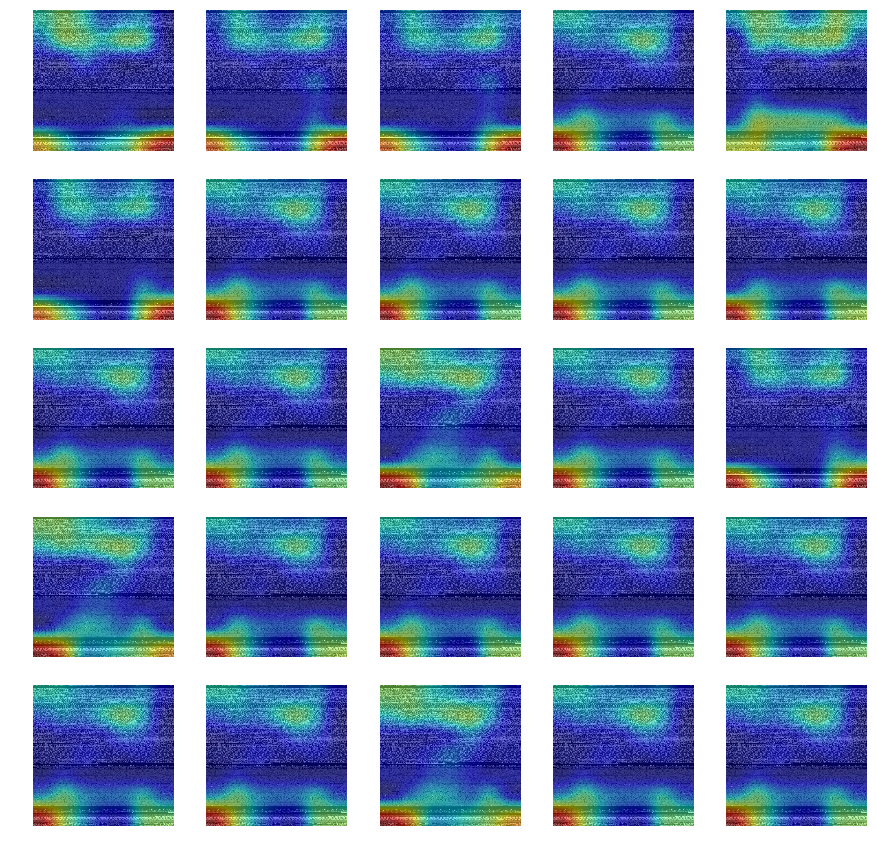

Family: Agent.FYI
Image: ['008778ef91e3f946dd2fba333f35e262.png'] - Class: ['Agent.FYI'] - Pred: 1 (Agent.FYI)
Image: ['0088ec78f2ab6a71a542621d65001ed2.png'] - Class: ['Agent.FYI'] - Pred: 1 (Agent.FYI)
Image: ['001c3641fcc9e6b9351f7b4c146544c4.png'] - Class: ['Agent.FYI'] - Pred: 1 (Agent.FYI)
Image: ['0093ef5545cb90af815f1c89e0ac4dcc.png'] - Class: ['Agent.FYI'] - Pred: 1 (Agent.FYI)
Image: ['0054971b8d88031a7f30c6fbc9a2552d.png'] - Class: ['Agent.FYI'] - Pred: 1 (Agent.FYI)
Image: ['001057ff216f82ad939c0a520711b093.png'] - Class: ['Agent.FYI'] - Pred: 1 (Agent.FYI)
Image: ['088c0581b722d2b2c25a61f21a19669c.png'] - Class: ['Agent.FYI'] - Pred: 1 (Agent.FYI)
Image: ['06371f78435d597efefb4319e03019f4.png'] - Class: ['Agent.FYI'] - Pred: 1 (Agent.FYI)
Image: ['00275a24e433a32333315022c5e1b520.png'] - Class: ['Agent.FYI'] - Pred: 1 (Agent.FYI)
Image: ['07310a8e5541a217284dd9ba48f99721.png'] - Class: ['Agent.FYI'] - Pred: 1 (Agent.FYI)
Image: ['004dddc6ee18a44a5f67e8bbd6a54205.png'] - Cl

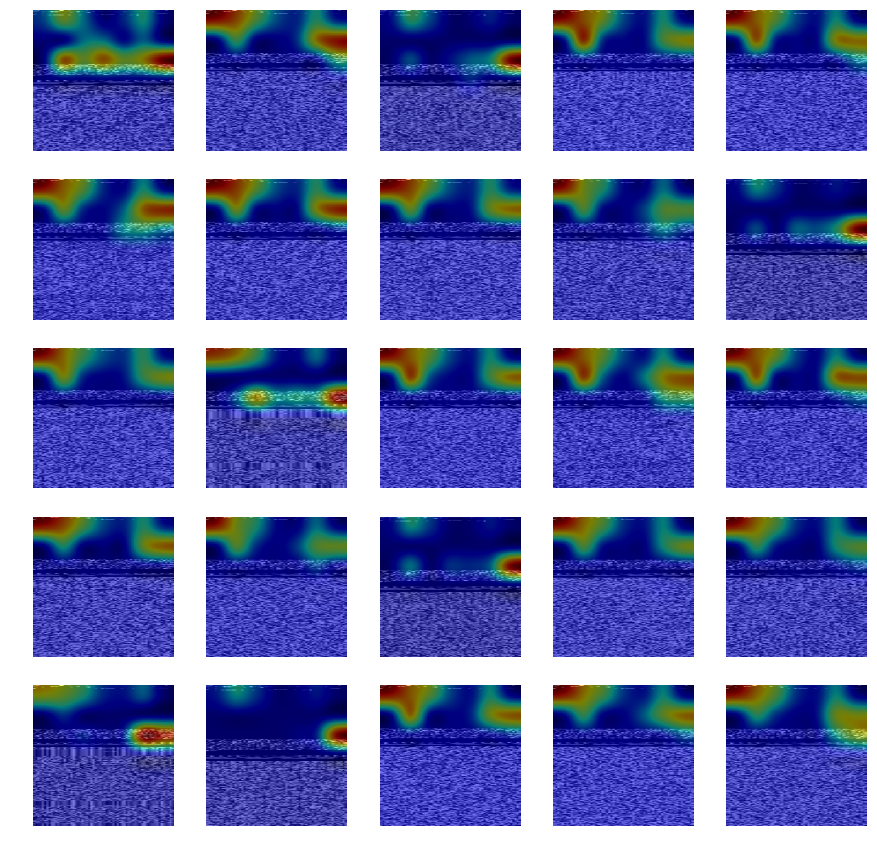

Family: Allaple.A
Image: ['088add9177b6fe5f9490e6b69579d71f.png'] - Class: ['Allaple.A'] - Pred: 2 (Allaple.A)
Image: ['081669ca686354174462c9103238efa9.png'] - Class: ['Allaple.A'] - Pred: 2 (Allaple.A)
Image: ['0071a55148ce1dbdc9de9a1e00b8f152.png'] - Class: ['Allaple.A'] - Pred: 2 (Allaple.A)
Image: ['0041e346ee2c9cac3e5886c5851a459c.png'] - Class: ['Allaple.A'] - Pred: 2 (Allaple.A)
Image: ['0059ac96637f2a2449dbe97e16f5491e.png'] - Class: ['Allaple.A'] - Pred: 2 (Allaple.A)
Image: ['061e93b8581b56b2d60338653e5c6952.png'] - Class: ['Allaple.A'] - Pred: 2 (Allaple.A)
Image: ['033b7455c666a6e88e41a1869f6d8efa.png'] - Class: ['Allaple.A'] - Pred: 2 (Allaple.A)
Image: ['017d98ac28c67d5a94ab602233ae2728.png'] - Class: ['Allaple.A'] - Pred: 2 (Allaple.A)
Image: ['050c7218b408be0502a8b65afed02d6f.png'] - Class: ['Allaple.A'] - Pred: 2 (Allaple.A)
Image: ['008d7e969639d6213faee6e26a57b297.png'] - Class: ['Allaple.A'] - Pred: 2 (Allaple.A)
Image: ['004ab2b7c0b649401105933ee621034b.png'] - Cl

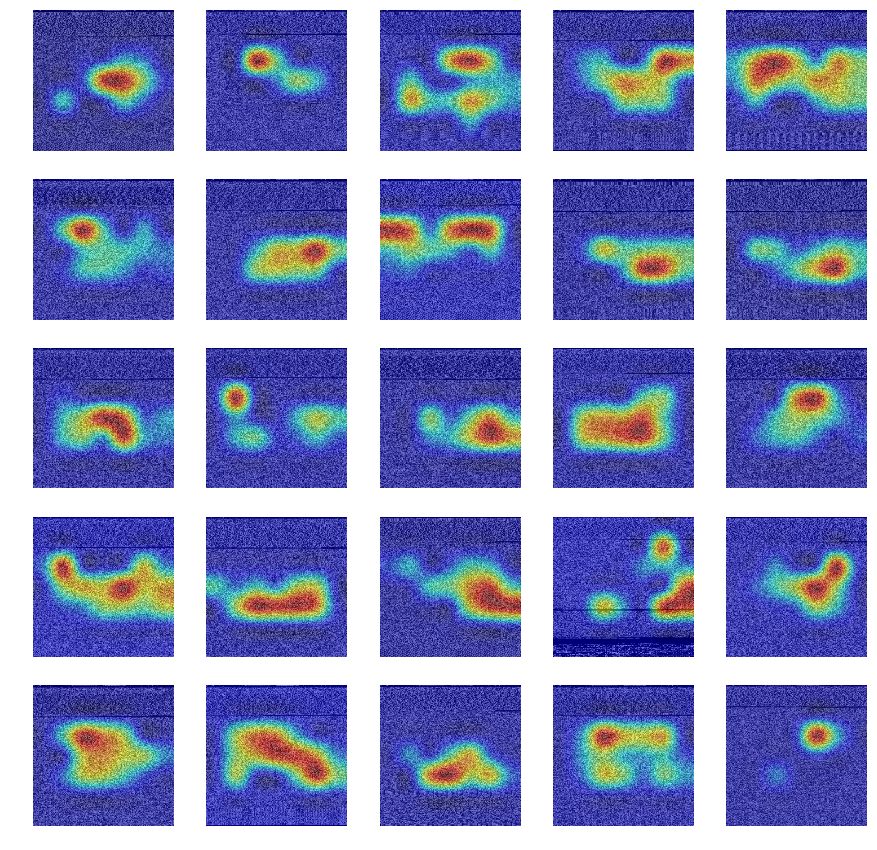

Family: Allaple.L
Image: ['04faab3ae979800b5d6223341f3da867.png'] - Class: ['Allaple.L'] - Pred: 3 (Allaple.L)
Image: ['07a267513dd82057f875506f2de63ec4.png'] - Class: ['Allaple.L'] - Pred: 3 (Allaple.L)
Image: ['03390984ec43d072264c5054ba969368.png'] - Class: ['Allaple.L'] - Pred: 3 (Allaple.L)
Image: ['082ebc5a3cc15b08024627aaabdf3b5d.png'] - Class: ['Allaple.L'] - Pred: 3 (Allaple.L)
Image: ['050cd48639cd13662603924241b49373.png'] - Class: ['Allaple.L'] - Pred: 3 (Allaple.L)
Image: ['002459b82caf7452eb9c9aec3730d7fe.png'] - Class: ['Allaple.L'] - Pred: 3 (Allaple.L)
Image: ['05aa70e3a03fd574fc6dfc254bdd8d9a.png'] - Class: ['Allaple.L'] - Pred: 3 (Allaple.L)
Image: ['009c19bcbeb41b7cb1469099d04d13b8.png'] - Class: ['Allaple.L'] - Pred: 3 (Allaple.L)
Image: ['00b0796f6542660f955d38c5c6ffa79f.png'] - Class: ['Allaple.L'] - Pred: 3 (Allaple.L)
Image: ['0356b644b60c968e1dd29292af35e33e.png'] - Class: ['Allaple.L'] - Pred: 3 (Allaple.L)
Image: ['06583d83c5278fac7cd20c015780c1d0.png'] - Cl

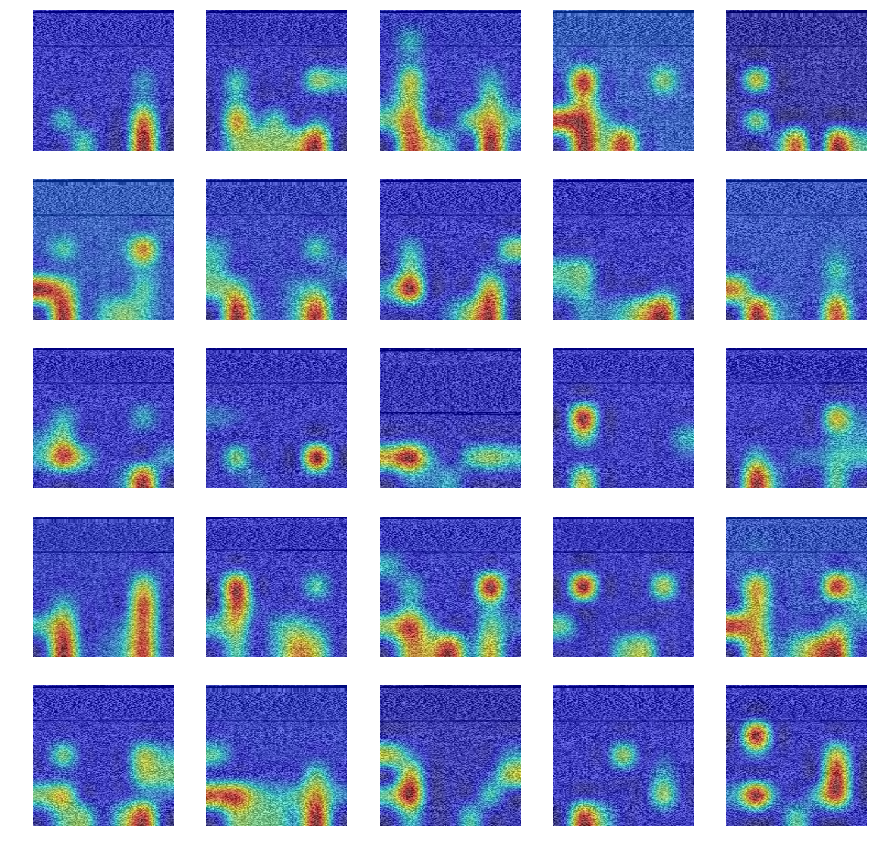

Family: Alueron.gen!J
Image: ['0763a035768cb6911878de458c65bf56.png'] - Class: ['Alueron.gen!J'] - Pred: 4 (Alueron.gen!J)
Image: ['06446b0705ca80f5aff02c7b51423b17.png'] - Class: ['Alueron.gen!J'] - Pred: 4 (Alueron.gen!J)
Image: ['06c1b8368e0cc48750d3d80e062d4f2b.png'] - Class: ['Alueron.gen!J'] - Pred: 4 (Alueron.gen!J)
Image: ['007b8e84bba5bc642dd0c8a7d80db369.png'] - Class: ['Alueron.gen!J'] - Pred: 4 (Alueron.gen!J)
Image: ['042853dcd82d0a1e64d5f888af8bc3e1.png'] - Class: ['Alueron.gen!J'] - Pred: 4 (Alueron.gen!J)
Image: ['070fda8ae1eb3ec2a73eae340a08c0c3.png'] - Class: ['Alueron.gen!J'] - Pred: 4 (Alueron.gen!J)
Image: ['03119d4ae0e9bbc358c9bfb8792ac49f.png'] - Class: ['Alueron.gen!J'] - Pred: 4 (Alueron.gen!J)
Image: ['0029104c8e261b2d5b4985ed0d02645b.png'] - Class: ['Alueron.gen!J'] - Pred: 4 (Alueron.gen!J)
Image: ['08add37e48066301bcfcb4ecf9e73cae.png'] - Class: ['Alueron.gen!J'] - Pred: 4 (Alueron.gen!J)
Image: ['01a4978d6e87a068165e30ab82fb41b8.png'] - Class: ['Alueron.ge

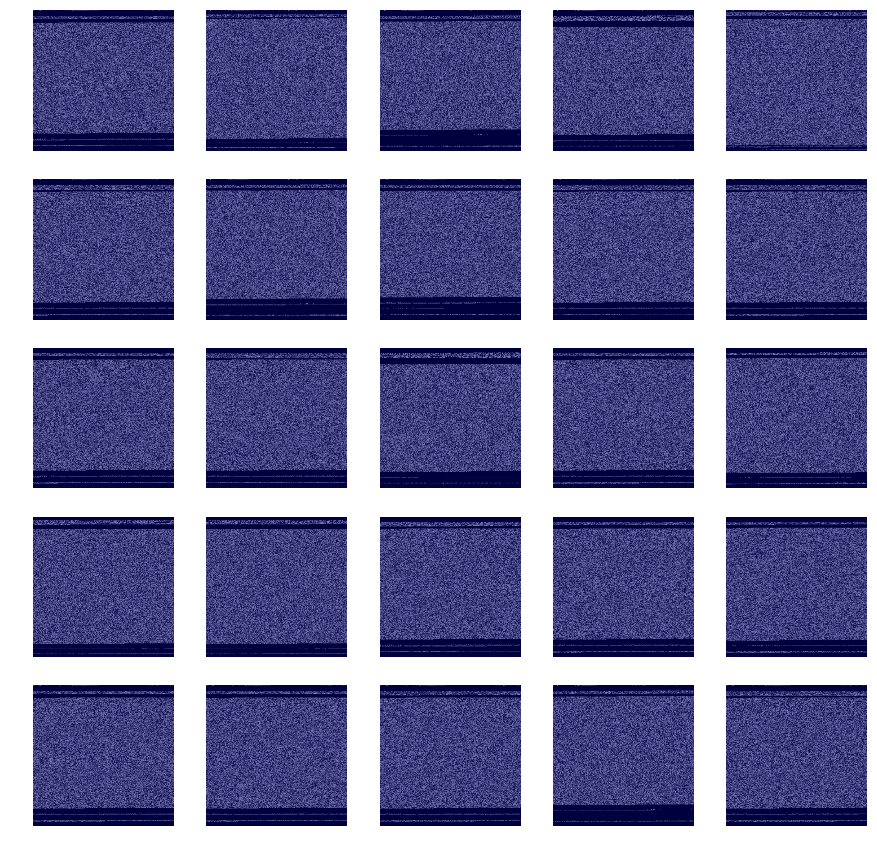

Family: Autorun.K
Image: ['078f9d0ab3c244ccb225d7c223131605.png'] - Class: ['Autorun.K'] - Pred: 24 (Yuner.A)
Image: ['01d3dd5cd0c2c5d08ab3d30d0930113e.png'] - Class: ['Autorun.K'] - Pred: 24 (Yuner.A)
Image: ['05b43c8f989f9a54840f666a9903773e.png'] - Class: ['Autorun.K'] - Pred: 24 (Yuner.A)
Image: ['0545e8afce3d8f22c08fdcffaa8fa425.png'] - Class: ['Autorun.K'] - Pred: 24 (Yuner.A)
Image: ['04344779dd1a7416ec04477ab910a1db.png'] - Class: ['Autorun.K'] - Pred: 24 (Yuner.A)
Image: ['018c6375a30243d7c110f562f368a97f.png'] - Class: ['Autorun.K'] - Pred: 24 (Yuner.A)
Image: ['04538003dba9058fd32dd2980753fbd8.png'] - Class: ['Autorun.K'] - Pred: 24 (Yuner.A)
Image: ['01d34acb2656dda27f12001984eb0100.png'] - Class: ['Autorun.K'] - Pred: 24 (Yuner.A)
Image: ['041f20138c4c5788b057a7f0606f001f.png'] - Class: ['Autorun.K'] - Pred: 24 (Yuner.A)
Image: ['04d5fbd406b593f6ebfca27e19be1608.png'] - Class: ['Autorun.K'] - Pred: 24 (Yuner.A)
Image: ['079a124fd60a10dd4893af114df39282.png'] - Class: ['Aut

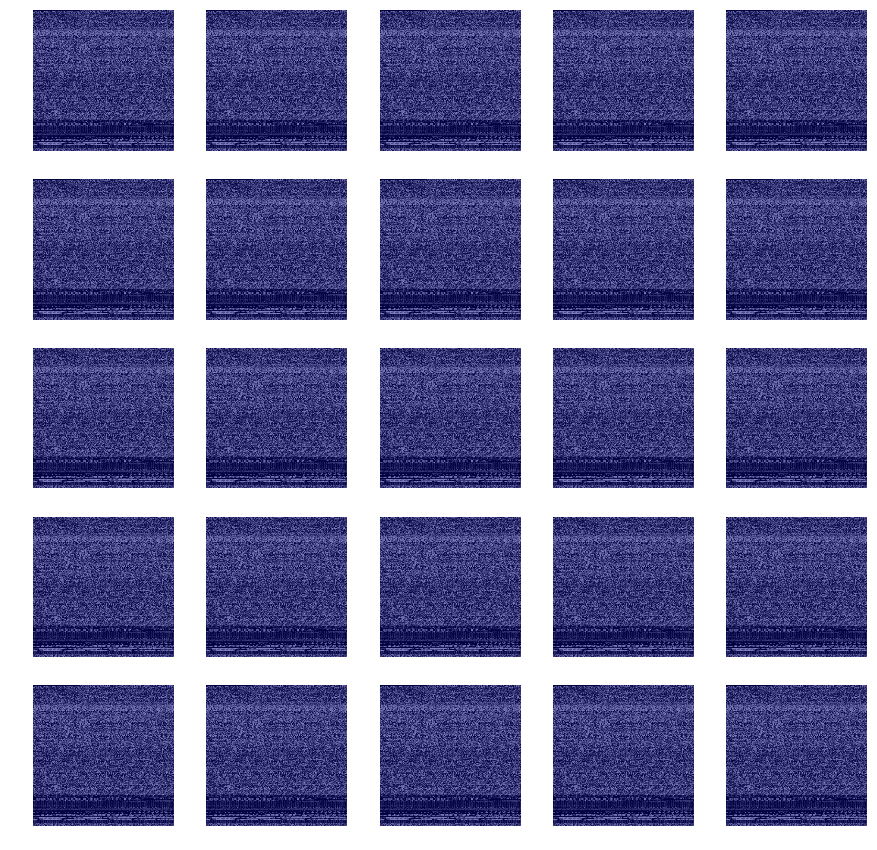

Family: C2LOP.gen!g
Image: ['001ed5b440e467fc248bb41899db918d.png'] - Class: ['C2LOP.gen!g'] - Pred: 6 (C2LOP.gen!g)
Image: ['01f8d9455be8a26c992703428ec440a9.png'] - Class: ['C2LOP.gen!g'] - Pred: 6 (C2LOP.gen!g)
Image: ['077f77e731ff65728ddee4fa6227d639.png'] - Class: ['C2LOP.gen!g'] - Pred: 6 (C2LOP.gen!g)
Image: ['003d5a2a4f048115034ae16b346fcd30.png'] - Class: ['C2LOP.gen!g'] - Pred: 6 (C2LOP.gen!g)
Image: ['073897d668356d8ed61f1b2a29bef1e6.png'] - Class: ['C2LOP.gen!g'] - Pred: 6 (C2LOP.gen!g)
Image: ['0503b57c774013bc3702d223647af138.png'] - Class: ['C2LOP.gen!g'] - Pred: 6 (C2LOP.gen!g)
Image: ['00b9ae29a14acfc0605368fb55aa03b6.png'] - Class: ['C2LOP.gen!g'] - Pred: 6 (C2LOP.gen!g)
Image: ['02de8936e29d19f555da0225d6f65465.png'] - Class: ['C2LOP.gen!g'] - Pred: 6 (C2LOP.gen!g)
Image: ['0312af51d4e0631cf7140918763d9258.png'] - Class: ['C2LOP.gen!g'] - Pred: 6 (C2LOP.gen!g)
Image: ['0310ba692d846e2d82e5e0ebfa236edd.png'] - Class: ['C2LOP.gen!g'] - Pred: 6 (C2LOP.gen!g)
Image: ['0

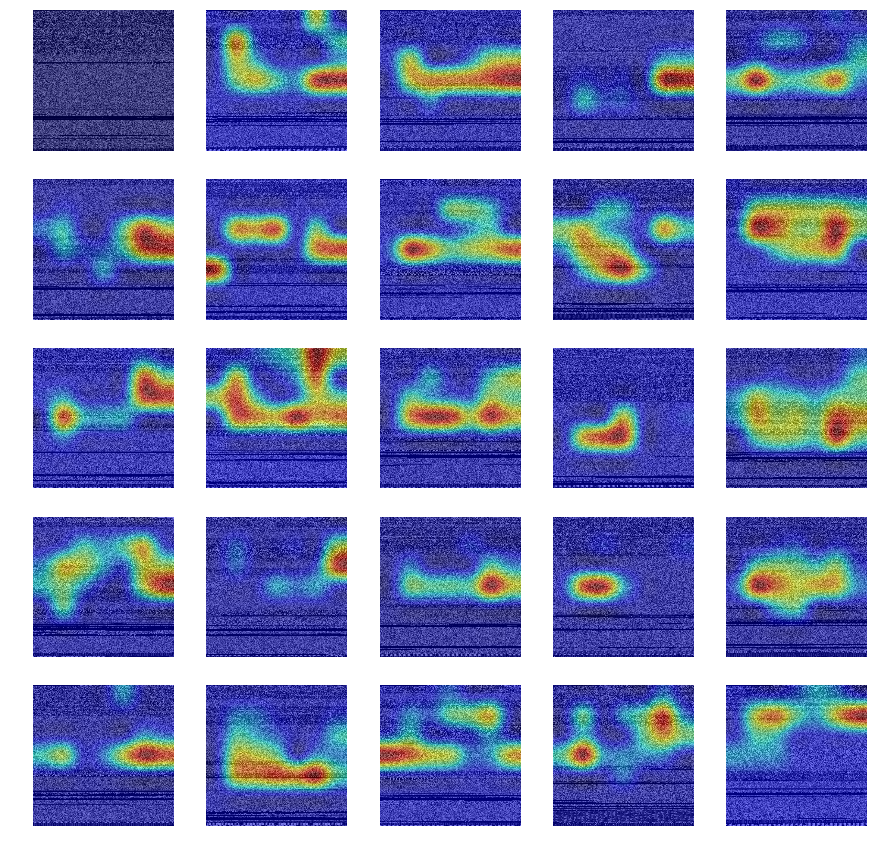

Family: C2LOP.P
Image: ['0742265cdc9c8ac02ebd1925227dbdd6.png'] - Class: ['C2LOP.P'] - Pred: 7 (C2LOP.P)
Image: ['064a23a2a1c1c934fe8ff16223b7b6a3.png'] - Class: ['C2LOP.P'] - Pred: 7 (C2LOP.P)
Image: ['005b615999cb5fae2afa0411ecc266ad.png'] - Class: ['C2LOP.P'] - Pred: 6 (C2LOP.gen!g)
Image: ['05cb7e9608214cf7a794f6809614ba2b.png'] - Class: ['C2LOP.P'] - Pred: 7 (C2LOP.P)
Image: ['0179a1905ad1d1dfe638f010ae0ad66a.png'] - Class: ['C2LOP.P'] - Pred: 7 (C2LOP.P)
Image: ['032e64f388dcaf7c2c6285394eee529c.png'] - Class: ['C2LOP.P'] - Pred: 7 (C2LOP.P)
Image: ['017548b075362b5d79caed9b8a825e19.png'] - Class: ['C2LOP.P'] - Pred: 7 (C2LOP.P)
Image: ['00edbfce1ca7b8068670cba2917c3211.png'] - Class: ['C2LOP.P'] - Pred: 7 (C2LOP.P)
Image: ['008841b99d44c9f609890c9612ca91ad.png'] - Class: ['C2LOP.P'] - Pred: 7 (C2LOP.P)
Image: ['08a5b2bc33b41d2877884d1df56efb2d.png'] - Class: ['C2LOP.P'] - Pred: 7 (C2LOP.P)
Image: ['0689ab716473297438d1fb9744787ef2.png'] - Class: ['C2LOP.P'] - Pred: 7 (C2LOP.P)
I

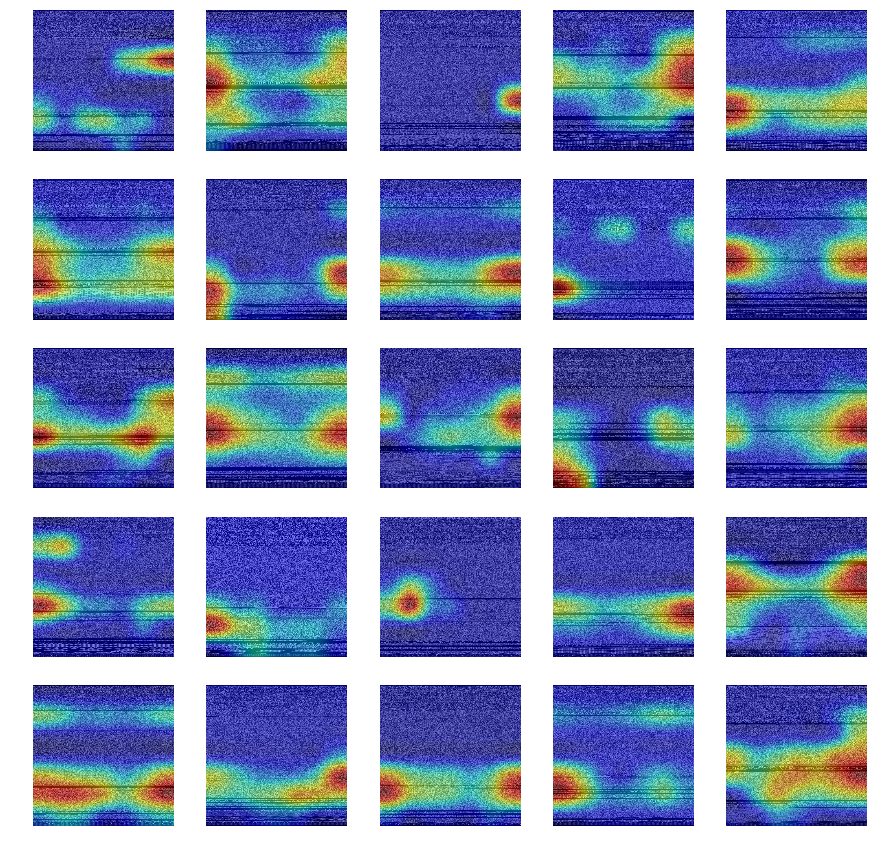

Family: Dialplatform.B
Image: ['0083c98fbc37c480098b889b54b54463.png'] - Class: ['Dialplatform.B'] - Pred: 8 (Dialplatform.B)
Image: ['0538c9af7cdb0ce7f6ed4bd2e5f5ce17.png'] - Class: ['Dialplatform.B'] - Pred: 8 (Dialplatform.B)
Image: ['009088d0af358e6ea2ece91803d20110.png'] - Class: ['Dialplatform.B'] - Pred: 8 (Dialplatform.B)
Image: ['00455be2b5e7a3e97295b4886649b623.png'] - Class: ['Dialplatform.B'] - Pred: 8 (Dialplatform.B)
Image: ['03858d6ebc32663f53e0c081895c213f.png'] - Class: ['Dialplatform.B'] - Pred: 8 (Dialplatform.B)
Image: ['05082772c2e68d8cf3944cc4c3c4176f.png'] - Class: ['Dialplatform.B'] - Pred: 8 (Dialplatform.B)
Image: ['076cd512141c295ca1734e6674bd6425.png'] - Class: ['Dialplatform.B'] - Pred: 8 (Dialplatform.B)
Image: ['072bfa69831bc7b961303724c2978c6c.png'] - Class: ['Dialplatform.B'] - Pred: 8 (Dialplatform.B)
Image: ['0090d445e2a4cdf2a964fdf8b9c39a58.png'] - Class: ['Dialplatform.B'] - Pred: 8 (Dialplatform.B)
Image: ['0145e93b33c8d8eef8719e74f6cc5c53.png'] - 

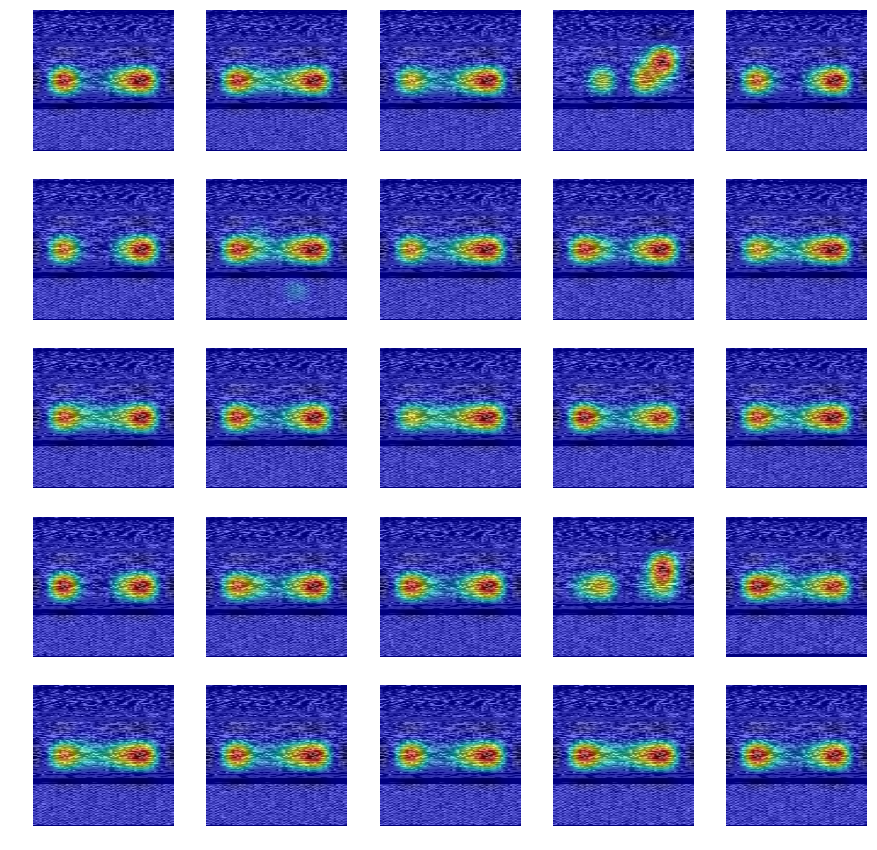

Family: Dontovo.A
Image: ['05e2d03db60ae328280539d511138281.png'] - Class: ['Dontovo.A'] - Pred: 9 (Dontovo.A)
Image: ['080dab5e9745fdf052d702b231707836.png'] - Class: ['Dontovo.A'] - Pred: 9 (Dontovo.A)
Image: ['01c3de8f13fd6cf40c52fc72488d494c.png'] - Class: ['Dontovo.A'] - Pred: 9 (Dontovo.A)
Image: ['00b9c56bcdb40ba9e7cab2d2085e3ccb.png'] - Class: ['Dontovo.A'] - Pred: 9 (Dontovo.A)
Image: ['0597e3f0dd6c407e67f65dbbd3b8d13a.png'] - Class: ['Dontovo.A'] - Pred: 9 (Dontovo.A)
Image: ['0694d2eaf437642960ae81441f681a3d.png'] - Class: ['Dontovo.A'] - Pred: 9 (Dontovo.A)
Image: ['07c964c217e92b9920255df4fd4fc716.png'] - Class: ['Dontovo.A'] - Pred: 9 (Dontovo.A)
Image: ['04edc62623447bcc52dcfae1a15a3621.png'] - Class: ['Dontovo.A'] - Pred: 9 (Dontovo.A)
Image: ['05092698bcc5098b67bbd5ec68b7243a.png'] - Class: ['Dontovo.A'] - Pred: 9 (Dontovo.A)
Image: ['05810c380d19c805dd270949c09ab517.png'] - Class: ['Dontovo.A'] - Pred: 9 (Dontovo.A)
Image: ['0194c873b5e79a576b1999d826bf56f2.png'] - Cl

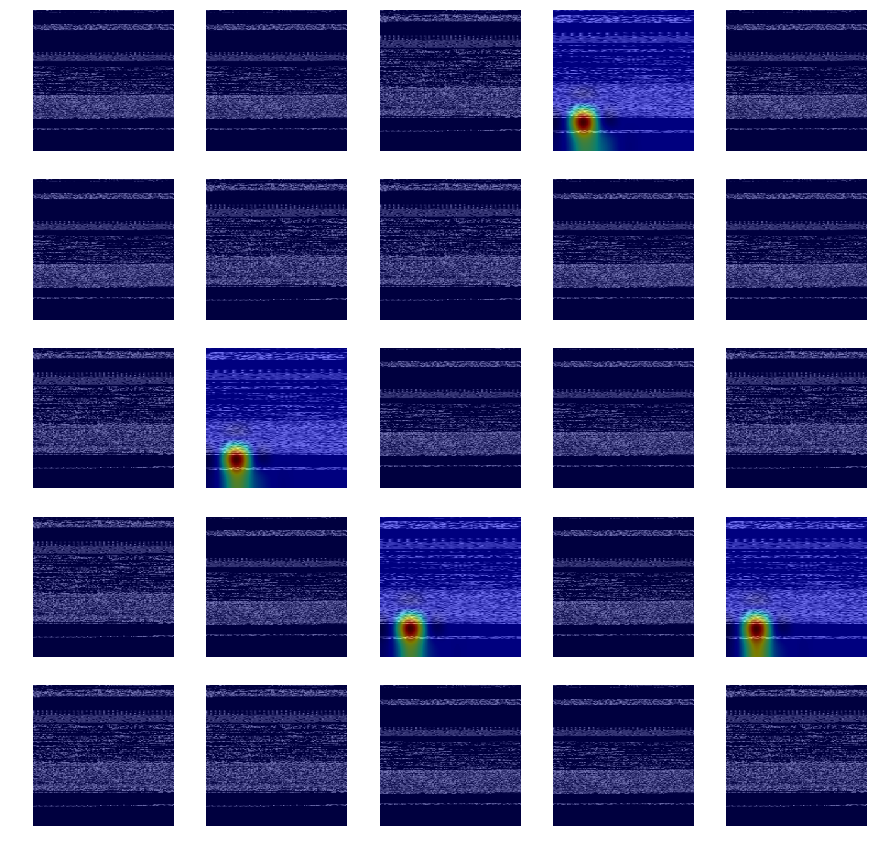

Family: Fakerean
Image: ['01660104081c1cd573011d79ab68c57a.png'] - Class: ['Fakerean'] - Pred: 10 (Fakerean)
Image: ['01f97b278c4788d209b7261ecf423154.png'] - Class: ['Fakerean'] - Pred: 10 (Fakerean)
Image: ['00abc972ee36e733f80de6f9e7ea7c86.png'] - Class: ['Fakerean'] - Pred: 10 (Fakerean)
Image: ['01353e57a2ec16302e5482531b4bc792.png'] - Class: ['Fakerean'] - Pred: 10 (Fakerean)
Image: ['065891ef36eaa9690c32a6694949e93b.png'] - Class: ['Fakerean'] - Pred: 10 (Fakerean)
Image: ['08926598a1a4bad85c1793f9cae99655.png'] - Class: ['Fakerean'] - Pred: 10 (Fakerean)
Image: ['003538bbbd49a53dc81f079588fc30c5.png'] - Class: ['Fakerean'] - Pred: 10 (Fakerean)
Image: ['0683c1ab47984ff178f2c819701ffb0b.png'] - Class: ['Fakerean'] - Pred: 10 (Fakerean)
Image: ['022d7a104007ac898aea601336b47eeb.png'] - Class: ['Fakerean'] - Pred: 10 (Fakerean)
Image: ['05924635723539939550e2355c199772.png'] - Class: ['Fakerean'] - Pred: 10 (Fakerean)
Image: ['021a6b31c825c90df5bffbaa8032c02a.png'] - Class: ['Fake

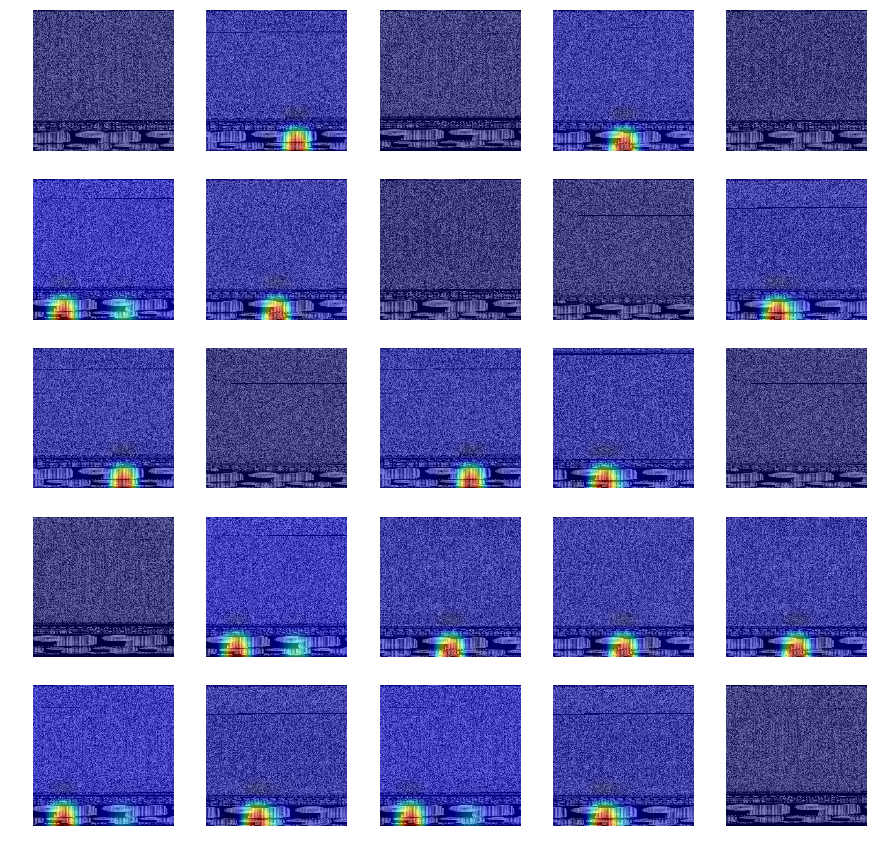

Family: Instantaccess
Image: ['04c72750d96bb30d764fc2b1f7fab887.png'] - Class: ['Instantaccess'] - Pred: 11 (Instantaccess)
Image: ['00f102a42c31be2728d1476ee63c1258.png'] - Class: ['Instantaccess'] - Pred: 11 (Instantaccess)
Image: ['07b63a0d1ba0d073cfbf7621475174ea.png'] - Class: ['Instantaccess'] - Pred: 11 (Instantaccess)
Image: ['00429081a572f7c33c262723360c9cf0.png'] - Class: ['Instantaccess'] - Pred: 11 (Instantaccess)
Image: ['05cd288462a658760873a3040e2c7480.png'] - Class: ['Instantaccess'] - Pred: 11 (Instantaccess)
Image: ['05e2570020c19b20e1d773b3b0a6f008.png'] - Class: ['Instantaccess'] - Pred: 11 (Instantaccess)
Image: ['0322230c8a0546b5e4aeba7030045943.png'] - Class: ['Instantaccess'] - Pred: 11 (Instantaccess)
Image: ['0422340e8a1296d1f8d1b39819ef7fd3.png'] - Class: ['Instantaccess'] - Pred: 11 (Instantaccess)
Image: ['00d44bee25e141be3b3ca0ebf9180010.png'] - Class: ['Instantaccess'] - Pred: 11 (Instantaccess)
Image: ['02fa3af51b46b13ac161f6353b7a8c5d.png'] - Class: ['I

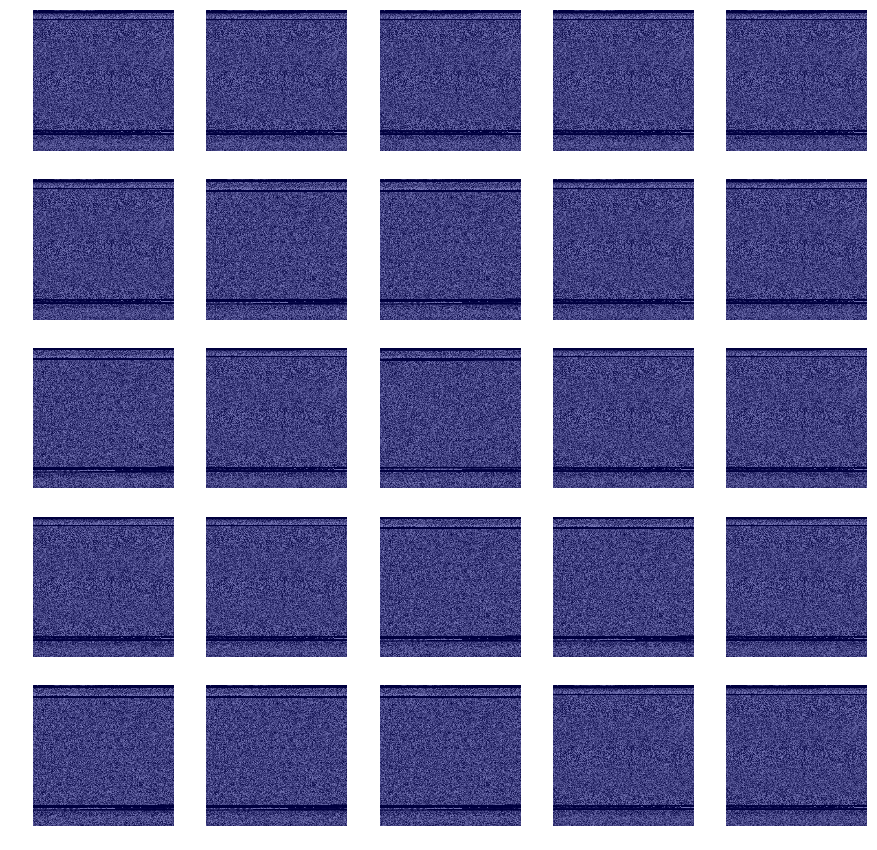

Family: Lolyda.AA1
Image: ['00cab11c9f00eb2560cabd15c4713f31.png'] - Class: ['Lolyda.AA1'] - Pred: 12 (Lolyda.AA1)
Image: ['0096f84f93f997129259b6b0af58f125.png'] - Class: ['Lolyda.AA1'] - Pred: 12 (Lolyda.AA1)
Image: ['001a1b3af2db30fe1e39c57dce1526fe.png'] - Class: ['Lolyda.AA1'] - Pred: 12 (Lolyda.AA1)
Image: ['00d5221927f8140ea0a3b243e9b5b7ae.png'] - Class: ['Lolyda.AA1'] - Pred: 12 (Lolyda.AA1)
Image: ['00ab4b2f1dbb7dde44139294d648d6d0.png'] - Class: ['Lolyda.AA1'] - Pred: 12 (Lolyda.AA1)
Image: ['00bc56df4350974ce61c3671e740c35e.png'] - Class: ['Lolyda.AA1'] - Pred: 12 (Lolyda.AA1)
Image: ['00f7f7f5820ca6312e3e26308df1ad37.png'] - Class: ['Lolyda.AA1'] - Pred: 12 (Lolyda.AA1)
Image: ['00493f41927347cc8a1c9f465e3b2b3a.png'] - Class: ['Lolyda.AA1'] - Pred: 12 (Lolyda.AA1)
Image: ['00c5950c571260e511783d9b81e2c58d.png'] - Class: ['Lolyda.AA1'] - Pred: 12 (Lolyda.AA1)
Image: ['00c5a590a6e342893dba5fb888527c19.png'] - Class: ['Lolyda.AA1'] - Pred: 12 (Lolyda.AA1)
Image: ['00c60274b1b7

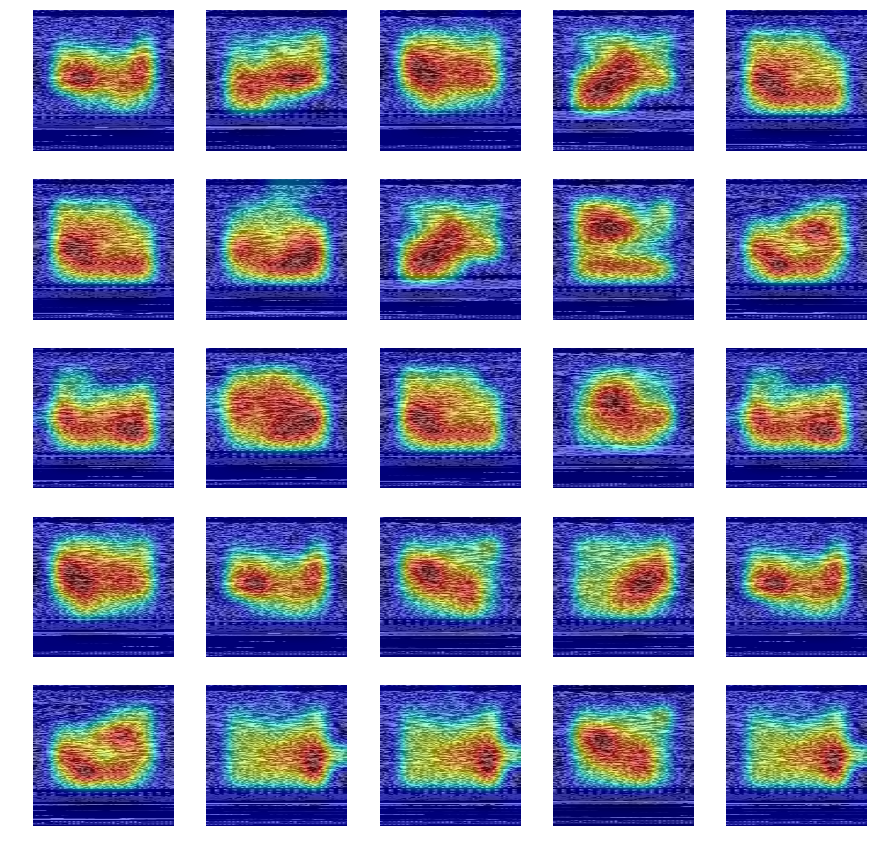

Family: Lolyda.AA2
Image: ['0035b12caf71358595b13836df14a0cb.png'] - Class: ['Lolyda.AA2'] - Pred: 13 (Lolyda.AA2)
Image: ['0058aa124e2dcb534e48606c0c47d2c4.png'] - Class: ['Lolyda.AA2'] - Pred: 13 (Lolyda.AA2)
Image: ['0081a245aa47cec8e50ed1995a84fbe0.png'] - Class: ['Lolyda.AA2'] - Pred: 13 (Lolyda.AA2)
Image: ['0019a179e375ee4d2da65b5e0da9ea28.png'] - Class: ['Lolyda.AA2'] - Pred: 13 (Lolyda.AA2)
Image: ['0016aa9c2ef17c233acf1f41ecc1830b.png'] - Class: ['Lolyda.AA2'] - Pred: 13 (Lolyda.AA2)
Image: ['00b774e91bf828fc282d07f365da4bfa.png'] - Class: ['Lolyda.AA2'] - Pred: 13 (Lolyda.AA2)
Image: ['00e52b55e47f5814d3ddbbdceabf9e71.png'] - Class: ['Lolyda.AA2'] - Pred: 13 (Lolyda.AA2)
Image: ['0095e681499a14f1fc6bac33264a569d.png'] - Class: ['Lolyda.AA2'] - Pred: 12 (Lolyda.AA1)
Image: ['00b02e950fd780b68bb19fc5c8c1955c.png'] - Class: ['Lolyda.AA2'] - Pred: 13 (Lolyda.AA2)
Image: ['00c0330e59a68713b721f041f56e1a08.png'] - Class: ['Lolyda.AA2'] - Pred: 13 (Lolyda.AA2)
Image: ['00adfef181ee

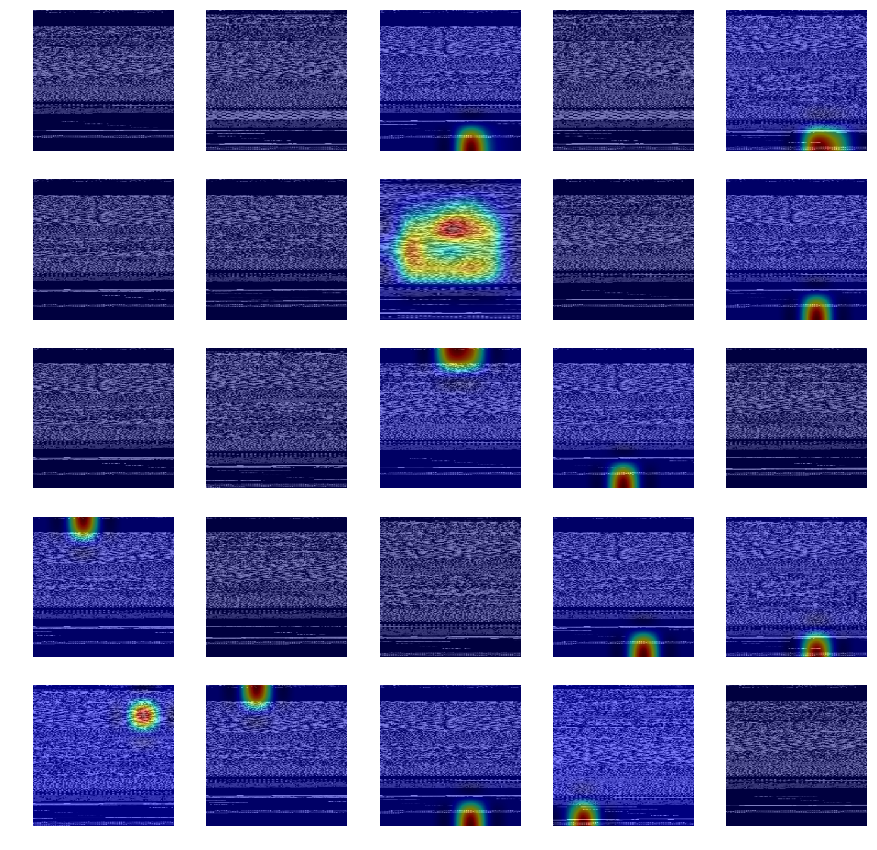

Family: Lolyda.AA3
Image: ['00ec19bbc3f669a8aaabfb203be72d9e.png'] - Class: ['Lolyda.AA3'] - Pred: 14 (Lolyda.AA3)
Image: ['0038e74cba5cf1d5e93e2456275f9181.png'] - Class: ['Lolyda.AA3'] - Pred: 14 (Lolyda.AA3)
Image: ['00897e4d046d4f69edc97fde33d8c9ca.png'] - Class: ['Lolyda.AA3'] - Pred: 14 (Lolyda.AA3)
Image: ['00a40fd56f0fed33286368fc0fc36d9a.png'] - Class: ['Lolyda.AA3'] - Pred: 14 (Lolyda.AA3)
Image: ['00266a037246b6fc0460eae1b4bd126f.png'] - Class: ['Lolyda.AA3'] - Pred: 14 (Lolyda.AA3)
Image: ['005b438811c6551f1010829646a32918.png'] - Class: ['Lolyda.AA3'] - Pred: 14 (Lolyda.AA3)
Image: ['008d378867463e92da2dd16435351127.png'] - Class: ['Lolyda.AA3'] - Pred: 14 (Lolyda.AA3)
Image: ['00a48575a427421077c2f6ad7a958b3e.png'] - Class: ['Lolyda.AA3'] - Pred: 14 (Lolyda.AA3)
Image: ['00676620667992a6bfdfbde7e25fe29b.png'] - Class: ['Lolyda.AA3'] - Pred: 14 (Lolyda.AA3)
Image: ['00e631fdf3851c31146e4de1ace2f1c6.png'] - Class: ['Lolyda.AA3'] - Pred: 14 (Lolyda.AA3)
Image: ['00754f9aed46

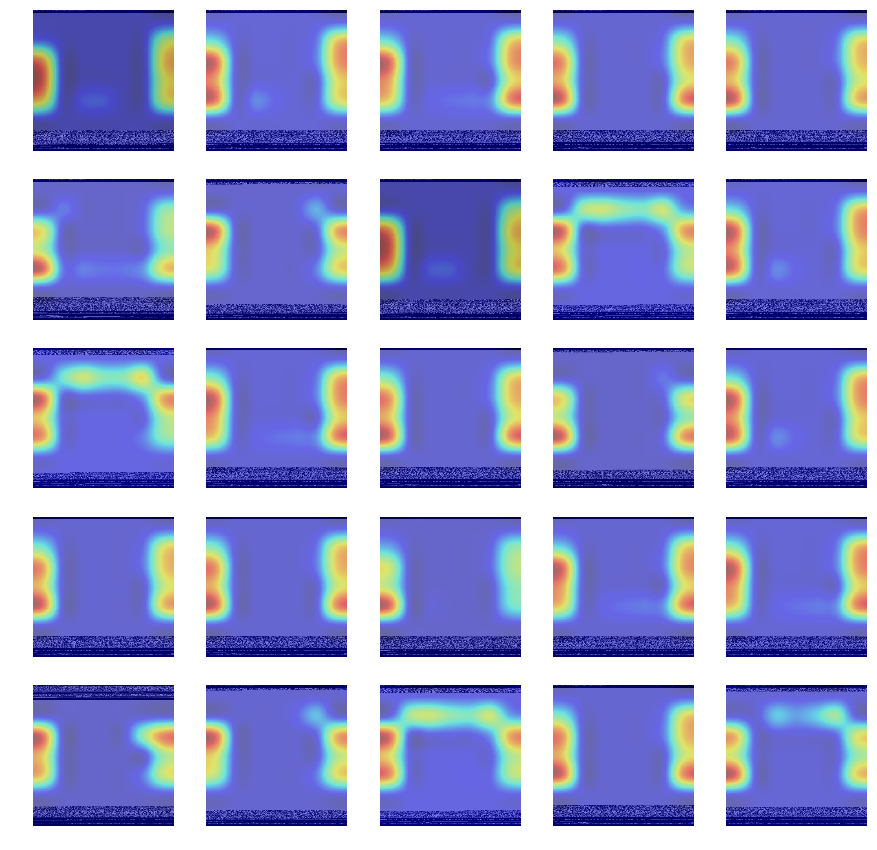

Family: Lolyda.AT
Image: ['01be98012aa72312f7f351ba5154e42b.png'] - Class: ['Lolyda.AT'] - Pred: 15 (Lolyda.AT)
Image: ['0416150e99501c7ecd68aa60cdf5d156.png'] - Class: ['Lolyda.AT'] - Pred: 15 (Lolyda.AT)
Image: ['0105124004fcaf4cfefa9c39678e1435.png'] - Class: ['Lolyda.AT'] - Pred: 15 (Lolyda.AT)
Image: ['01c4ff8acb385ed4ab85ea09a14565a1.png'] - Class: ['Lolyda.AT'] - Pred: 15 (Lolyda.AT)
Image: ['052aa1312fb26a8e3d7321dc81318c1f.png'] - Class: ['Lolyda.AT'] - Pred: 15 (Lolyda.AT)
Image: ['000dce1e85c83c4d776b2e6c2dc3ab3b.png'] - Class: ['Lolyda.AT'] - Pred: 15 (Lolyda.AT)
Image: ['088f5bdbfc6eb9a9f7c6cad09df76525.png'] - Class: ['Lolyda.AT'] - Pred: 15 (Lolyda.AT)
Image: ['00a44ad3a558bb54e42db90d93fc7cfb.png'] - Class: ['Lolyda.AT'] - Pred: 15 (Lolyda.AT)
Image: ['040f672253c2577350ef675aab5faf13.png'] - Class: ['Lolyda.AT'] - Pred: 15 (Lolyda.AT)
Image: ['067c868207fb1a58ce9657bda56befc6.png'] - Class: ['Lolyda.AT'] - Pred: 15 (Lolyda.AT)
Image: ['04ccdcdb176d1f003a75697457e6f5ad.

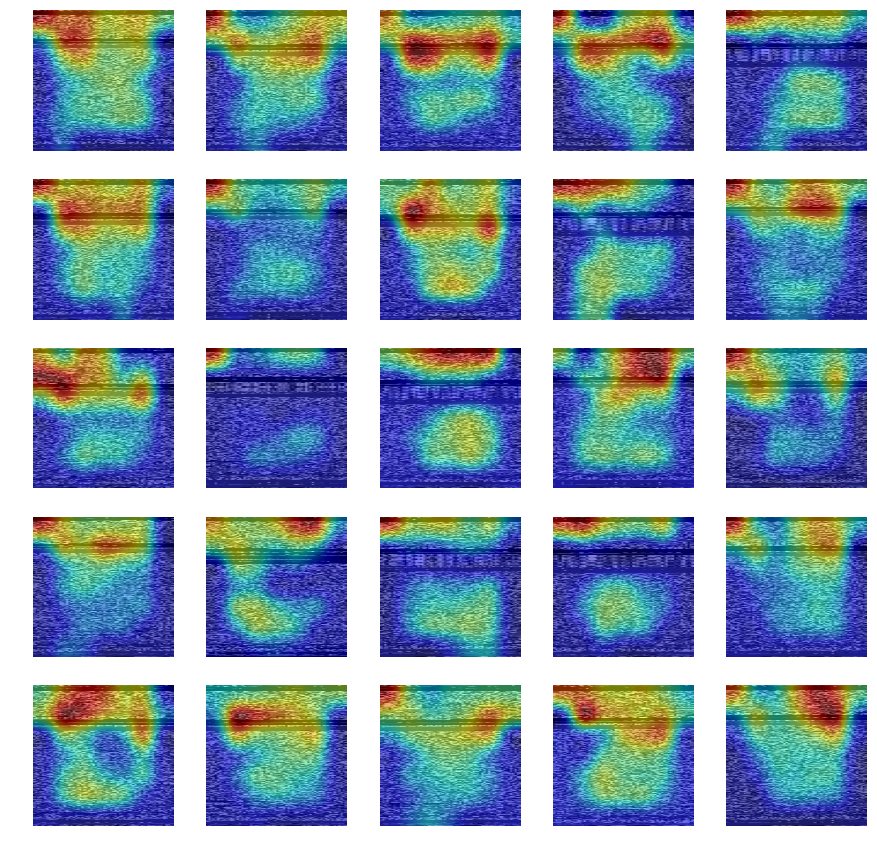

Family: Malex.gen!J
Image: ['005636eb6d4f97972c2e74d3b21d0d30.png'] - Class: ['Malex.gen!J'] - Pred: 16 (Malex.gen!J)
Image: ['06b4b341fb6076aba0f0fed9ceea8fad.png'] - Class: ['Malex.gen!J'] - Pred: 16 (Malex.gen!J)
Image: ['003b0b71bc2a10909291f93e07e39399.png'] - Class: ['Malex.gen!J'] - Pred: 16 (Malex.gen!J)
Image: ['03e9954cb5139179b15f5112601ed3f4.png'] - Class: ['Malex.gen!J'] - Pred: 16 (Malex.gen!J)
Image: ['04c676b3dae7e29b669766da2a96e17b.png'] - Class: ['Malex.gen!J'] - Pred: 16 (Malex.gen!J)
Image: ['05487692600de92411386d5983cd63be.png'] - Class: ['Malex.gen!J'] - Pred: 16 (Malex.gen!J)
Image: ['0635a56172dfe322edd1933d115516c8.png'] - Class: ['Malex.gen!J'] - Pred: 16 (Malex.gen!J)
Image: ['03b93357dbe7fadd15ac6ea71cb1df2d.png'] - Class: ['Malex.gen!J'] - Pred: 16 (Malex.gen!J)
Image: ['065f33b1125bce8df1f914b0ce654489.png'] - Class: ['Malex.gen!J'] - Pred: 16 (Malex.gen!J)
Image: ['05df3b57489aefd8246fa66e864b10b7.png'] - Class: ['Malex.gen!J'] - Pred: 16 (Malex.gen!J)


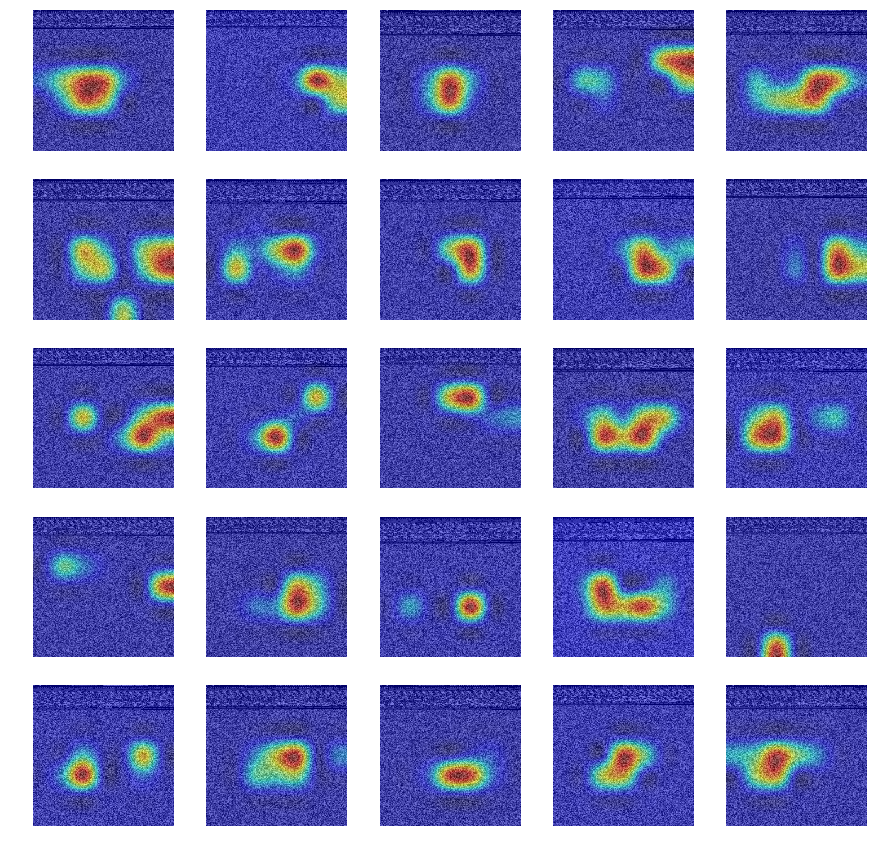

Family: Obfuscator.AD
Image: ['03b5390796da5c48db7b924af3cc258d.png'] - Class: ['Obfuscator.AD'] - Pred: 17 (Obfuscator.AD)
Image: ['0507ae864c1fc264846abc09916dd9d1.png'] - Class: ['Obfuscator.AD'] - Pred: 17 (Obfuscator.AD)
Image: ['054ee7f5981c841c83dec0b12a4b6fe7.png'] - Class: ['Obfuscator.AD'] - Pred: 17 (Obfuscator.AD)
Image: ['07e1f4d873519034c84d3bc2ca8947eb.png'] - Class: ['Obfuscator.AD'] - Pred: 17 (Obfuscator.AD)
Image: ['061b48dab1eabd6b7258a670752bfba0.png'] - Class: ['Obfuscator.AD'] - Pred: 17 (Obfuscator.AD)
Image: ['0522c13b646b6e441ad50e119e07ebc7.png'] - Class: ['Obfuscator.AD'] - Pred: 17 (Obfuscator.AD)
Image: ['08ad59da14d2a7a12e3df5def85f9173.png'] - Class: ['Obfuscator.AD'] - Pred: 17 (Obfuscator.AD)
Image: ['000a05c1d0ef03d9bb70fef29e91b395.png'] - Class: ['Obfuscator.AD'] - Pred: 17 (Obfuscator.AD)
Image: ['0140c3665b3bd049fc0e97a5d36bf343.png'] - Class: ['Obfuscator.AD'] - Pred: 17 (Obfuscator.AD)
Image: ['07a6541bece47858eb1cb93538c690fc.png'] - Class: ['O

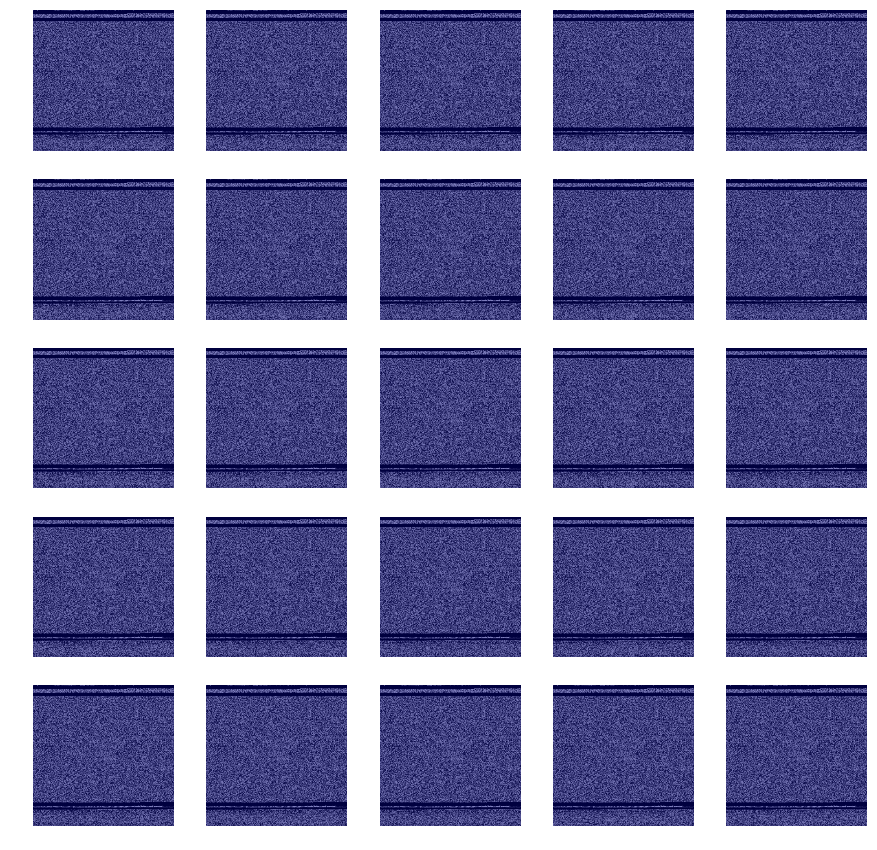

Family: Rbot!gen
Image: ['a2a10e623932861412917429c7f7626e.png'] - Class: ['Rbot!gen'] - Pred: 18 (Rbot!gen)
Image: ['e433e5035ce9eaf8619db425bc6314aa.png'] - Class: ['Rbot!gen'] - Pred: 18 (Rbot!gen)
Image: ['23a527a0d96622ca906ea13b47b92dd6.png'] - Class: ['Rbot!gen'] - Pred: 18 (Rbot!gen)
Image: ['c19d447ac95fcd2bd51e8423866ea99d.png'] - Class: ['Rbot!gen'] - Pred: 18 (Rbot!gen)
Image: ['248a95d2266f4ff3f5dc6d9d0dd9aefe.png'] - Class: ['Rbot!gen'] - Pred: 18 (Rbot!gen)
Image: ['0b363e34828dd0d04e2c9e60e6aee5a5.png'] - Class: ['Rbot!gen'] - Pred: 18 (Rbot!gen)
Image: ['1c886124b0875b9efec1ce1887e3b87d.png'] - Class: ['Rbot!gen'] - Pred: 18 (Rbot!gen)
Image: ['8c1a2ab433d0d4ea50b5e3ada0d85d08.png'] - Class: ['Rbot!gen'] - Pred: 18 (Rbot!gen)
Image: ['11de3a6394005bb198a6ac31853c19e8.png'] - Class: ['Rbot!gen'] - Pred: 18 (Rbot!gen)
Image: ['d4d53d0b20d5befe436f356f399644cb.png'] - Class: ['Rbot!gen'] - Pred: 18 (Rbot!gen)
Image: ['7409f08588d747283700d9990f3e1709.png'] - Class: ['Rbot

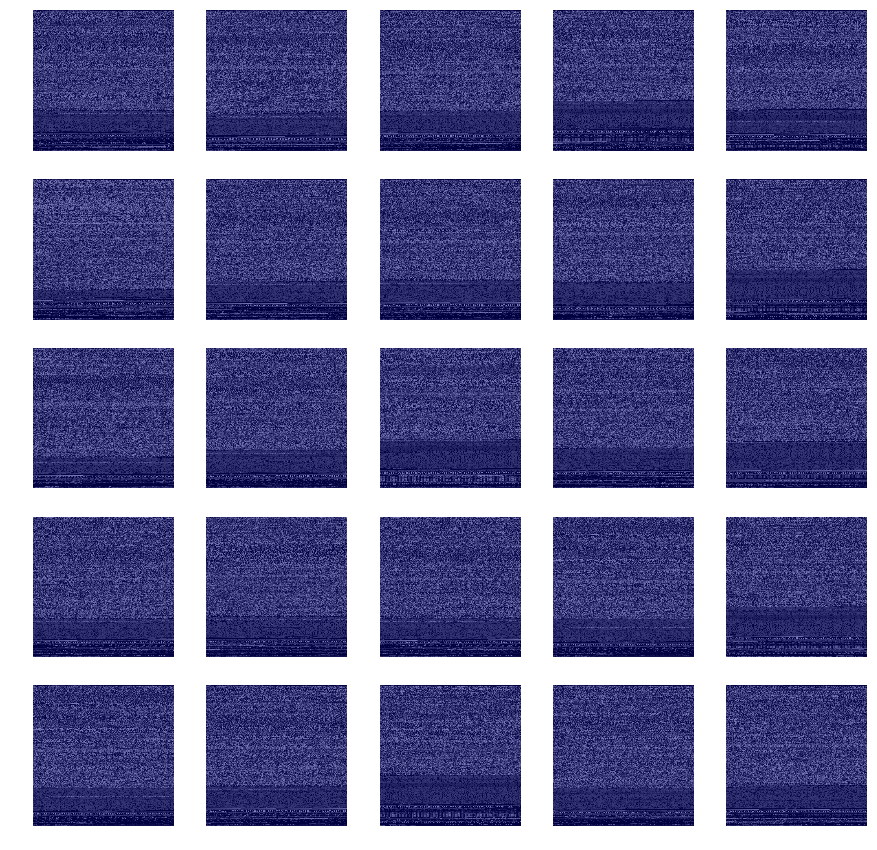

Family: Skintrim.N
Image: ['0065c030d0b3dde744d5950c490682f9.png'] - Class: ['Skintrim.N'] - Pred: 19 (Skintrim.N)
Image: ['0017bcef83e5a2a920dd6473957791a9.png'] - Class: ['Skintrim.N'] - Pred: 19 (Skintrim.N)
Image: ['005bfd1b610acd50deabbe46b853af9f.png'] - Class: ['Skintrim.N'] - Pred: 19 (Skintrim.N)
Image: ['005487148fd62225d33cccb082fcfd9a.png'] - Class: ['Skintrim.N'] - Pred: 19 (Skintrim.N)
Image: ['002df897a473cde62caa1672c5cff23e.png'] - Class: ['Skintrim.N'] - Pred: 19 (Skintrim.N)
Image: ['00c133fa5a153ad3bbcb0464669726b0.png'] - Class: ['Skintrim.N'] - Pred: 19 (Skintrim.N)
Image: ['004e162dee9beb4394a57c1be8a33204.png'] - Class: ['Skintrim.N'] - Pred: 19 (Skintrim.N)
Image: ['00db5a7775e02a5513748f354b0fb547.png'] - Class: ['Skintrim.N'] - Pred: 19 (Skintrim.N)
Image: ['00c09ee887ebd67fef68052fda144995.png'] - Class: ['Skintrim.N'] - Pred: 19 (Skintrim.N)
Image: ['00495e3496b359716244c80d6f5148f5.png'] - Class: ['Skintrim.N'] - Pred: 19 (Skintrim.N)
Image: ['0037fcbc215c

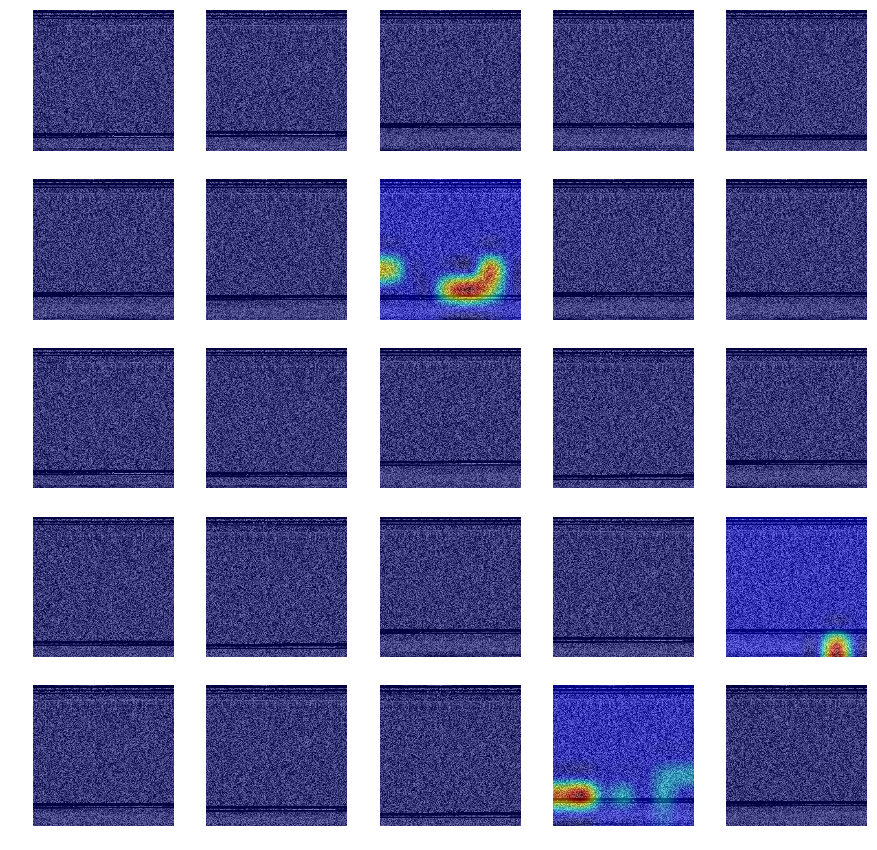

Family: Swizzor.gen!E
Image: ['036a17c77bbf14eb0fc8c2d39e7c06ed.png'] - Class: ['Swizzor.gen!E'] - Pred: 20 (Swizzor.gen!E)
Image: ['008f4aa97451513770c6ce4ae46c6853.png'] - Class: ['Swizzor.gen!E'] - Pred: 20 (Swizzor.gen!E)
Image: ['07366eadd70d4b4ff6f2e348fcf32021.png'] - Class: ['Swizzor.gen!E'] - Pred: 20 (Swizzor.gen!E)
Image: ['051371c58e124df8a675be263dc34597.png'] - Class: ['Swizzor.gen!E'] - Pred: 21 (Swizzor.gen!I)
Image: ['077376db808fc64057a05922724f9ad7.png'] - Class: ['Swizzor.gen!E'] - Pred: 20 (Swizzor.gen!E)
Image: ['0451baccf669d622f5adb269a5c82cb2.png'] - Class: ['Swizzor.gen!E'] - Pred: 21 (Swizzor.gen!I)
Image: ['01669bf8026257fe90c276b39f86aca3.png'] - Class: ['Swizzor.gen!E'] - Pred: 20 (Swizzor.gen!E)
Image: ['07230bfbfa5f1011a2d97b796d0c891d.png'] - Class: ['Swizzor.gen!E'] - Pred: 20 (Swizzor.gen!E)
Image: ['0398371fcad306b42ccdc73a85f3dfce.png'] - Class: ['Swizzor.gen!E'] - Pred: 20 (Swizzor.gen!E)
Image: ['05aea2ecc92157ff1e414d399b822684.png'] - Class: ['S

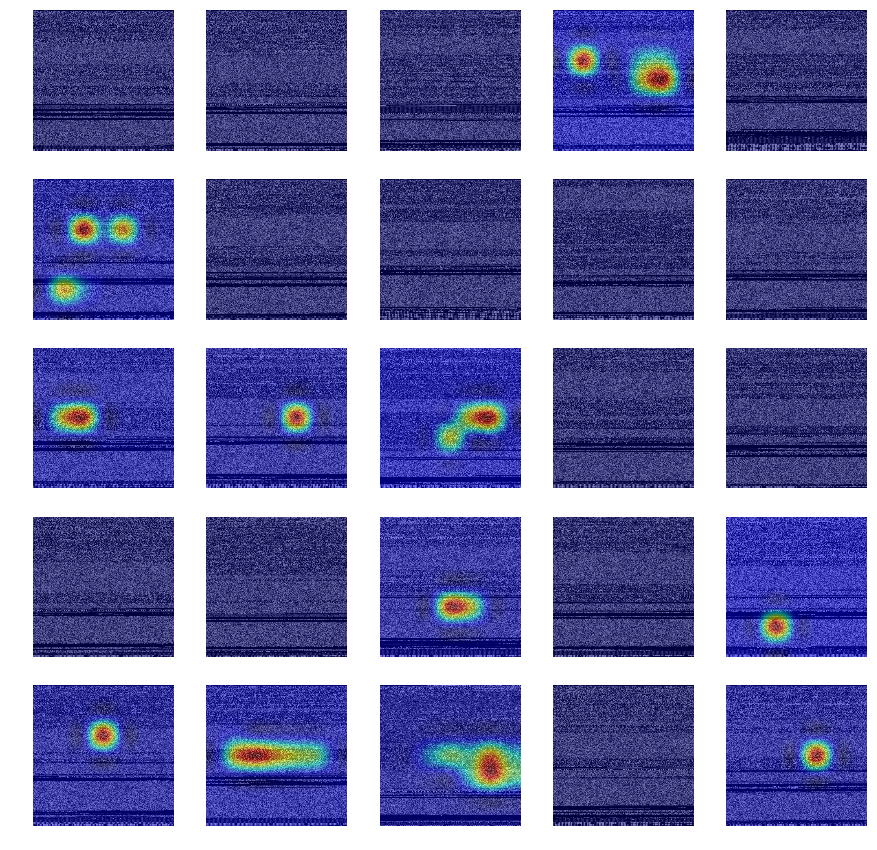

Family: Swizzor.gen!I
Image: ['051aca4afb65ae4ba03bb4db1ca85616.png'] - Class: ['Swizzor.gen!I'] - Pred: 21 (Swizzor.gen!I)
Image: ['00fdec29e4f91e2a4106e987d0457911.png'] - Class: ['Swizzor.gen!I'] - Pred: 21 (Swizzor.gen!I)
Image: ['00dba691bc6facafb58cd157b068cd01.png'] - Class: ['Swizzor.gen!I'] - Pred: 21 (Swizzor.gen!I)
Image: ['08a634679ddd53b886f667b3c42abc49.png'] - Class: ['Swizzor.gen!I'] - Pred: 21 (Swizzor.gen!I)
Image: ['01d015f05538ae89cef4d90e8530c56f.png'] - Class: ['Swizzor.gen!I'] - Pred: 21 (Swizzor.gen!I)
Image: ['036d088eaae689d87ea29df30ce46b64.png'] - Class: ['Swizzor.gen!I'] - Pred: 21 (Swizzor.gen!I)
Image: ['060e5538a1eb862eb3580c59df50ef39.png'] - Class: ['Swizzor.gen!I'] - Pred: 21 (Swizzor.gen!I)
Image: ['000beddf5e7f49a1718bfd5586e93665.png'] - Class: ['Swizzor.gen!I'] - Pred: 21 (Swizzor.gen!I)
Image: ['01edb6e816033bd3e0598757b9b886ed.png'] - Class: ['Swizzor.gen!I'] - Pred: 21 (Swizzor.gen!I)
Image: ['08a62d426b935575116ebb121d0e317a.png'] - Class: ['S

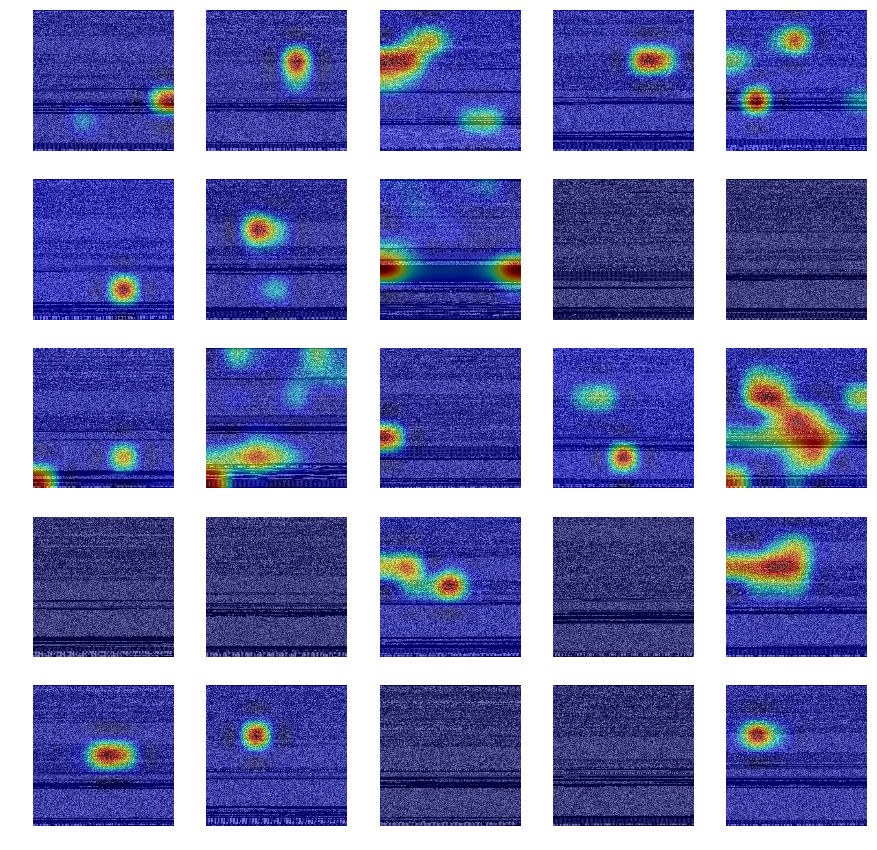

Family: VB.AT
Image: ['008e17d1530097ff0a9cd02a371c8979.png'] - Class: ['VB.AT'] - Pred: 22 (VB.AT)
Image: ['04bcc1b7eee28b737c86b036c1a77f85.png'] - Class: ['VB.AT'] - Pred: 22 (VB.AT)
Image: ['002001489663e435b75dbc837e2486bc.png'] - Class: ['VB.AT'] - Pred: 22 (VB.AT)
Image: ['051bf321b07d1ec74364b73cfad4088b.png'] - Class: ['VB.AT'] - Pred: 22 (VB.AT)
Image: ['04bb646a73f103a2da50f55f2cf5d2b9.png'] - Class: ['VB.AT'] - Pred: 22 (VB.AT)
Image: ['0115806f2738e59e7f0d68c3bcbcd35f.png'] - Class: ['VB.AT'] - Pred: 22 (VB.AT)
Image: ['079ed7dfd97c9b986609acbc203b1a9e.png'] - Class: ['VB.AT'] - Pred: 22 (VB.AT)
Image: ['03789e5463d4b95cf14770932b4633d7.png'] - Class: ['VB.AT'] - Pred: 22 (VB.AT)
Image: ['035a3f8b0f91a71b3b6c617b4024af30.png'] - Class: ['VB.AT'] - Pred: 22 (VB.AT)
Image: ['022277075b68eebb9df2eaa7486e3edf.png'] - Class: ['VB.AT'] - Pred: 22 (VB.AT)
Image: ['03e1abdf32265f1f2f6c291597f49562.png'] - Class: ['VB.AT'] - Pred: 22 (VB.AT)
Image: ['002e5dbcda5422468a8fd7c18250532

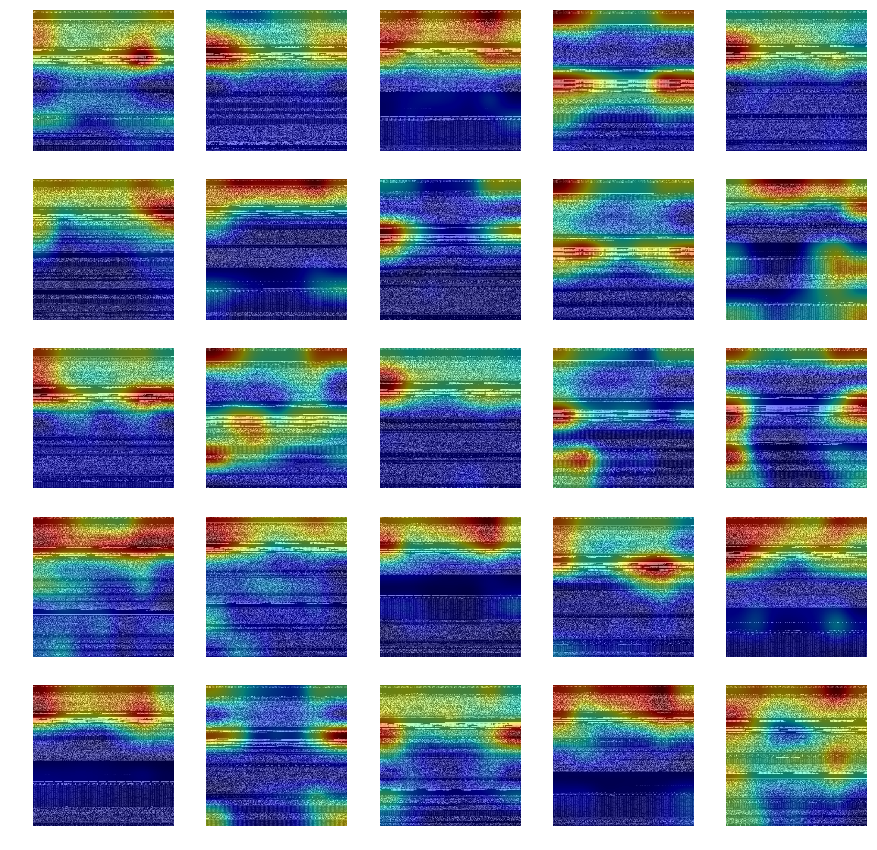

Family: Wintrim.BX
Image: ['00146911cdffd8064cfb97fc78a7bc07.png'] - Class: ['Wintrim.BX'] - Pred: 23 (Wintrim.BX)
Image: ['00f3a351d7122bfd5ab56567314bf2b5.png'] - Class: ['Wintrim.BX'] - Pred: 23 (Wintrim.BX)
Image: ['00a898f7bd4a810ae81d9b5ee1b7486f.png'] - Class: ['Wintrim.BX'] - Pred: 23 (Wintrim.BX)
Image: ['00e1812a1354a133d7c861253602e68f.png'] - Class: ['Wintrim.BX'] - Pred: 23 (Wintrim.BX)
Image: ['007b839f1227be054a927b9179b3748d.png'] - Class: ['Wintrim.BX'] - Pred: 23 (Wintrim.BX)
Image: ['0067ad9bcb06e4fc5b5303f15472b229.png'] - Class: ['Wintrim.BX'] - Pred: 23 (Wintrim.BX)
Image: ['0009e6db1b9505d85950d112a0b7acc4.png'] - Class: ['Wintrim.BX'] - Pred: 23 (Wintrim.BX)
Image: ['00a16098a3807ed534c9fb31fb43221d.png'] - Class: ['Wintrim.BX'] - Pred: 23 (Wintrim.BX)
Image: ['00c8829ac08f2bda11798831501239e4.png'] - Class: ['Wintrim.BX'] - Pred: 23 (Wintrim.BX)
Image: ['00c989f16ebfe791aad082be0c53ad6b.png'] - Class: ['Wintrim.BX'] - Pred: 23 (Wintrim.BX)
Image: ['00fd1aa6e299

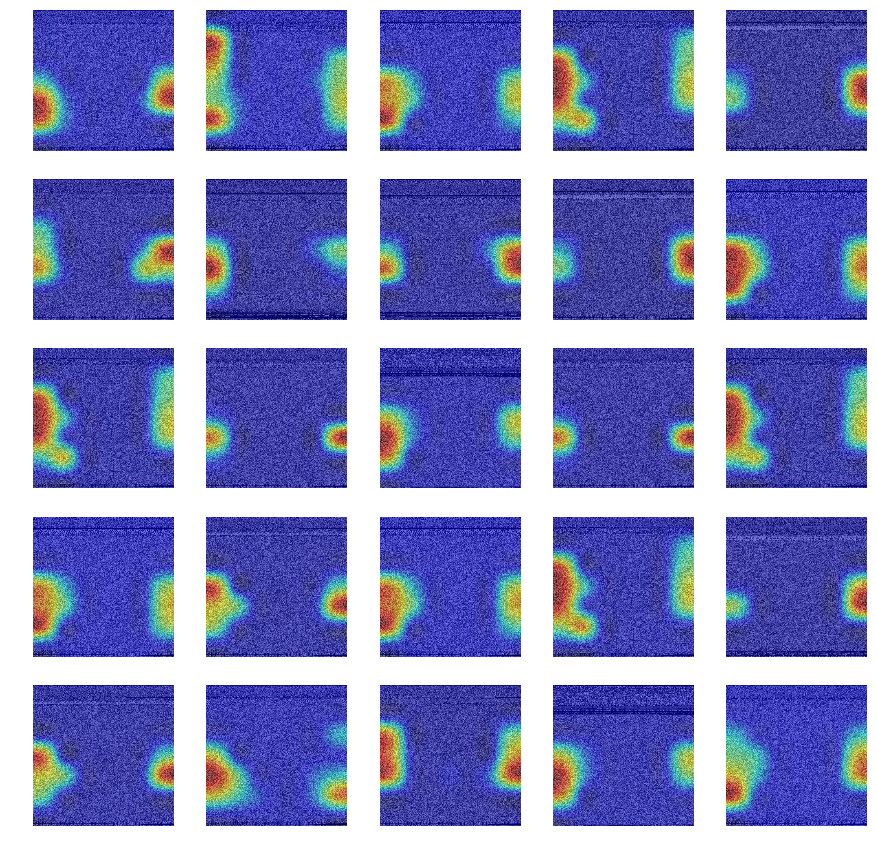

Family: Yuner.A
Image: ['0744ac5dcaa7823a2a862ecaeea4c490.png'] - Class: ['Yuner.A'] - Pred: 24 (Yuner.A)
Image: ['0554a26d2ed57746168b6ff01c79d48b.png'] - Class: ['Yuner.A'] - Pred: 24 (Yuner.A)
Image: ['03b26fd69a9b60eb319c3e38672785cf.png'] - Class: ['Yuner.A'] - Pred: 24 (Yuner.A)
Image: ['056685374dab0cc85e12cb5fad11ce3b.png'] - Class: ['Yuner.A'] - Pred: 24 (Yuner.A)
Image: ['0073f21cfa148ae211e48611119f439f.png'] - Class: ['Yuner.A'] - Pred: 24 (Yuner.A)
Image: ['08845585a169053275546a5f64cae5cd.png'] - Class: ['Yuner.A'] - Pred: 24 (Yuner.A)
Image: ['0460438a6cecb4afa9b906e23eb01f78.png'] - Class: ['Yuner.A'] - Pred: 24 (Yuner.A)
Image: ['059f4382a56f56120f283acd1b220686.png'] - Class: ['Yuner.A'] - Pred: 24 (Yuner.A)
Image: ['03b1298a2cf67a74b5bce1bd22c9c535.png'] - Class: ['Yuner.A'] - Pred: 24 (Yuner.A)
Image: ['04682a7a5e84237f746215e5c564b9bc.png'] - Class: ['Yuner.A'] - Pred: 24 (Yuner.A)
Image: ['06231ad14d1d8bb1efcd71b56ad1bdbc.png'] - Class: ['Yuner.A'] - Pred: 24 (Yun

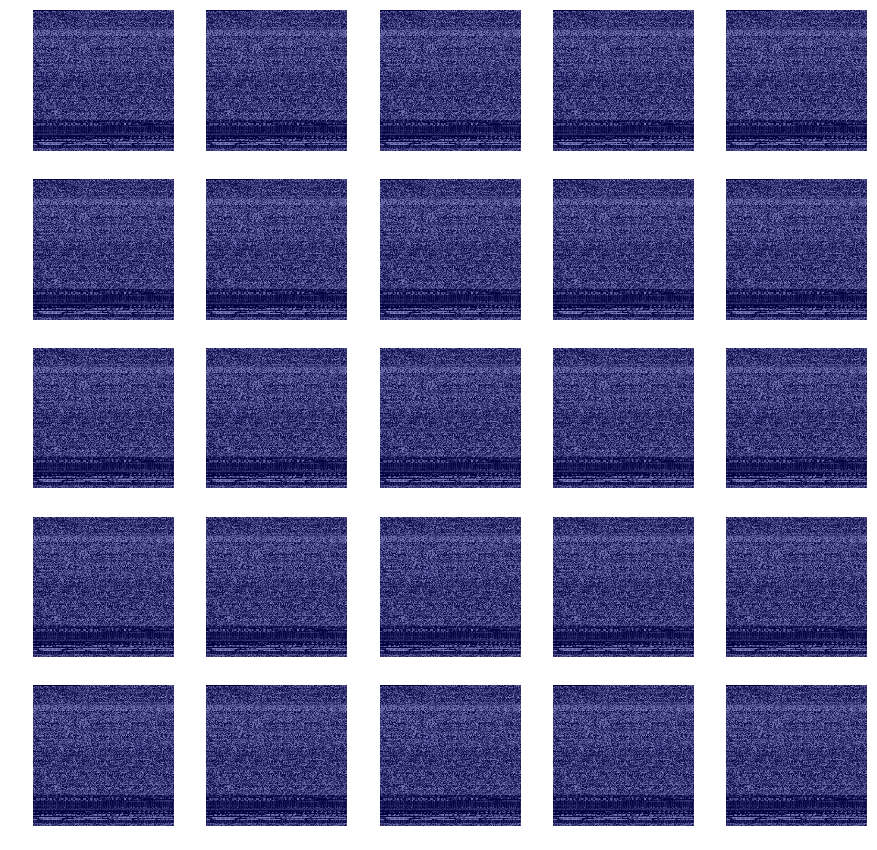

In [16]:
samplesbyfamily = 25
samplesbyrow = 5
for fam in list_fams:
    print("Family: %s" %(fam))
    fam_samples = [name for name in list_paths if fam in name]
    image_paths = random.sample(fam_samples, samplesbyfamily)
    
    #fig = plt.figure(figsize=(16, 8))
    f, ax = plt.subplots(samplesbyfamily//samplesbyrow, samplesbyrow)
    f.set_size_inches(3*samplesbyrow, 3*(samplesbyfamily//samplesbyrow))
    ind = 0
    
    for path in image_paths:
        # Predict the corresponding class for use in `visualize_cam`.
        #img = io.imread(path)
        #img = cv2.cvtColor(img,cv2.COLOR_GRAY2RGB)
        #img = cv2.resize(img, (224, 224))
        #pred_class = np.argmax(model.predict(np.array([img_to_array(img)])))
        
        img = io.imread(path)
        img = cv2.cvtColor(img,cv2.COLOR_GRAY2RGB)
        img = cv2.resize(img, (224, 224))
        img = image.img_to_array(img)
        #imgpre = preprocess_input(img)
        pred_class = np.argmax(model.predict(np.array([img])))
        print("Image: %s - Class: %s - Pred: %d (%s)" %(path.split('/')[-1:],path.split('/')[-2:-1],pred_class,list_fams[pred_class]))
        
        heatmapguided = visualize_cam(model, layer_idx, filter_indices=[pred_class], seed_input=img, backprop_modifier='guided')        
        
        ax[ind//samplesbyrow,ind%samplesbyrow].axis('off')
        ax[ind//samplesbyrow,ind%samplesbyrow].imshow(overlay(heatmapguided, img))
        ind = ind + 1
        
    plt.show()